In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"]= '3'
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import loadmat, savemat
import multielec_src.fitting as fitting
import multielec_src.multielec_utils as mutils
import statsmodels.api as sm
from mpl_toolkits.mplot3d import Axes3D
from copy import deepcopy
import torch
import gpytorch
from gpytorch.means import ConstantMean, LinearMean, ZeroMean
from gpytorch.kernels import RBFKernel
from gpytorch.likelihoods import GaussianLikelihood
import visionloader as vl

In [2]:
mapping = loadmat('/Volumes/Lab/Users/AlexG/pystim/files/adj-elecs-tools/newLVChan2Elec519.mat')['channel2Elec519'].flatten()

def is_valid_set(numbers, is_30um=True):
    """
    Checks if the input set of numbers (1-512) is valid.
    A valid set contains numbers only from either all odd or all even index groups.

    Parameters:
        numbers (array-like): List or array of unique numbers in the range 1-512.

    Returns:
        bool: True if valid, False otherwise.
    """
    numbers = np.asarray(numbers)
    if is_30um:
        transformed_numbers = []
        for number in numbers:
            ind = np.where(mapping == number)[0][0] + 1
            transformed_numbers.append(ind)
    
        numbers = np.asarray(transformed_numbers)

    # Compute the chunk indices (0-7) for each number
    chunk_indices = (numbers - 1) // 64

    # Check if all indices are even or all are odd
    return np.all(chunk_indices % 2 == 0) or np.all(chunk_indices % 2 == 1)    

Processing 2020-09-29-2 data007 kilosort_data006/data006
Pattern 536, cell 228
OFF parasol


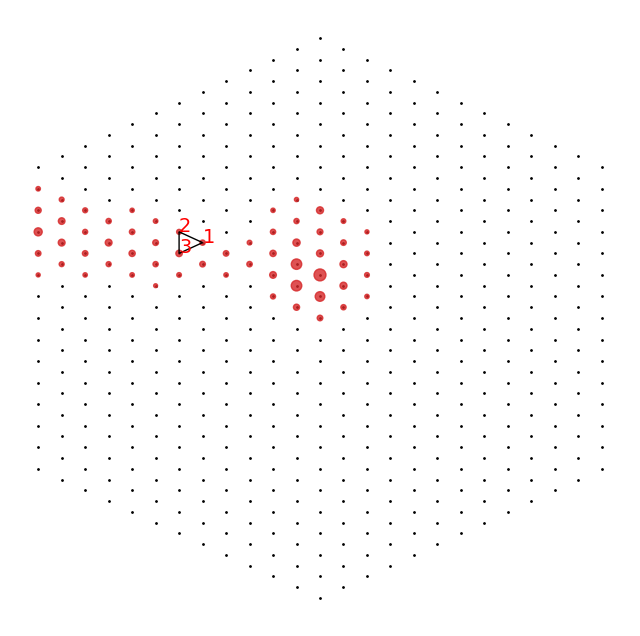

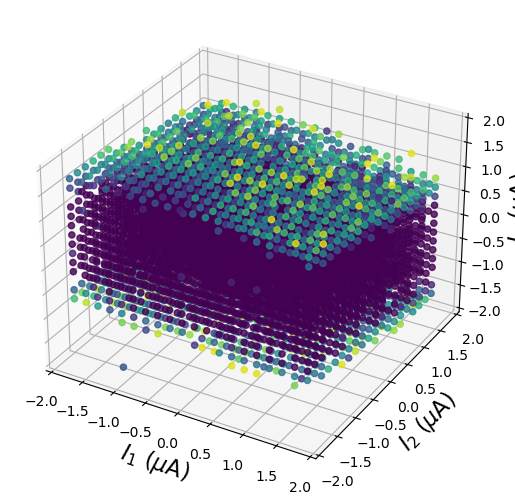

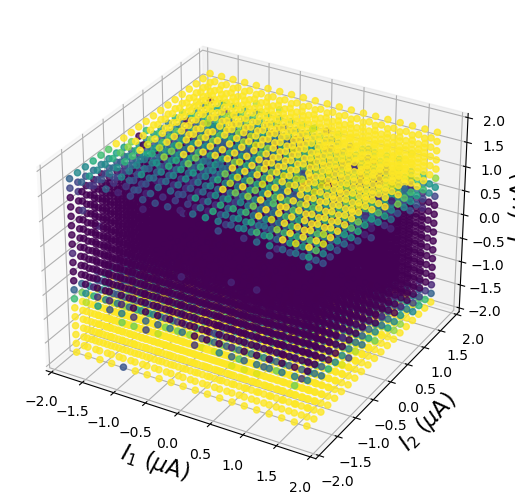

Early stopping triggered at iteration 57


/Volumes/Lab/Development/miniconda-peggyo/envs/pvasi39-pytorch/lib/python3.9/site-packages/gpytorch/models/exact_gp.py:284: GPInputWarning: The input matches the stored training data. Did you forget to call model.train()?
  warnings.warn(


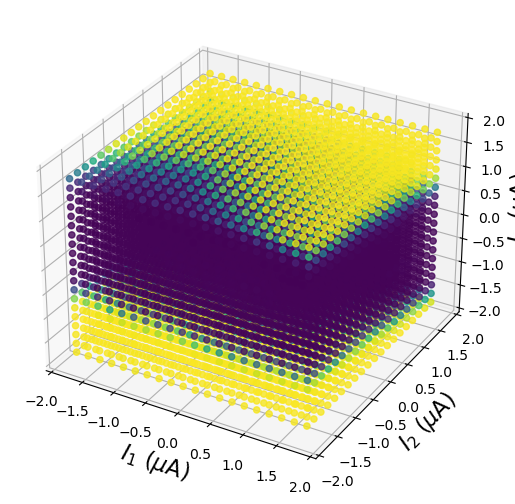

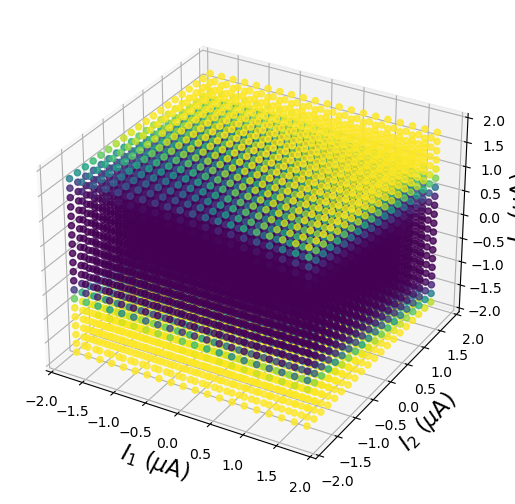

Pattern 536, cell 59
OFF parasol


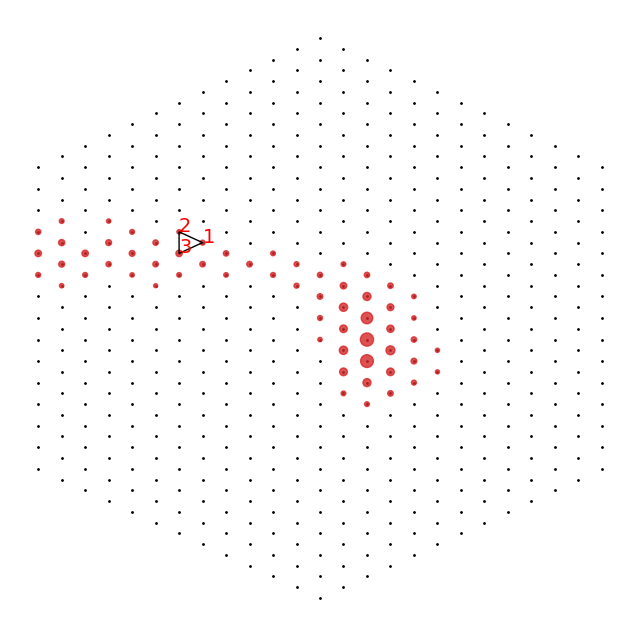

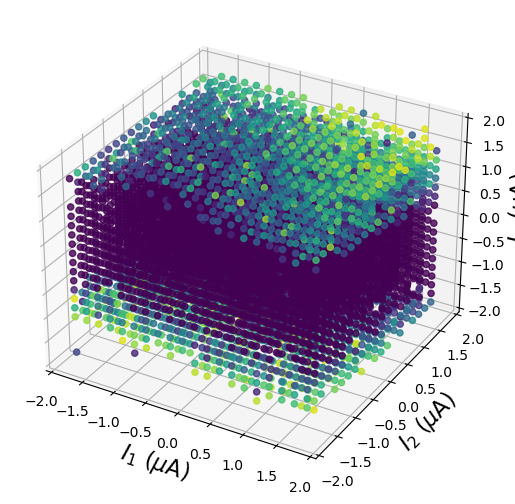

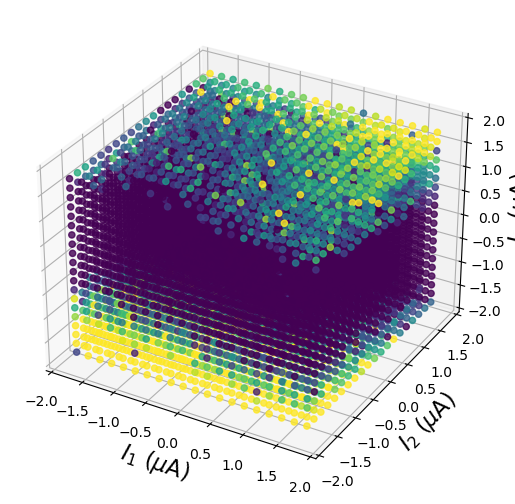

Early stopping triggered at iteration 45


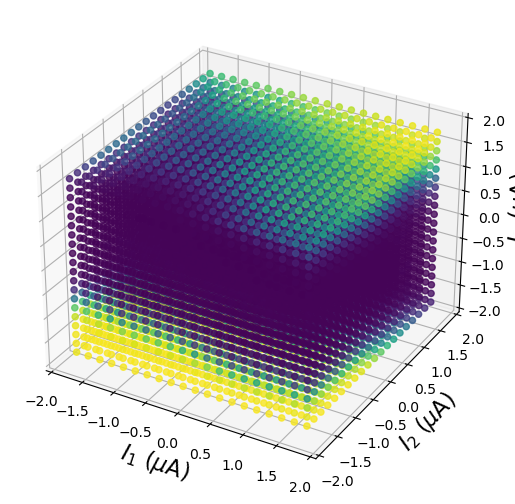

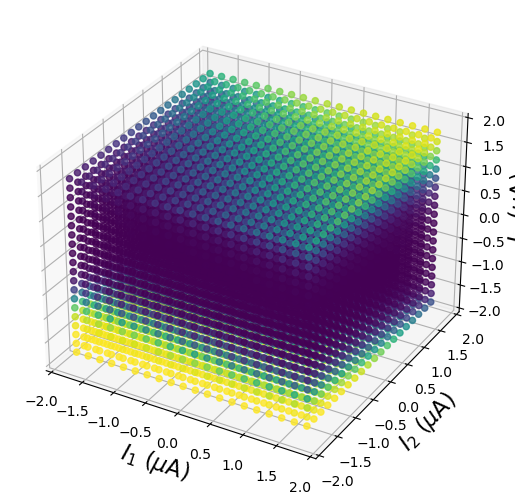

Pattern 536, cell 328
OFF parasol


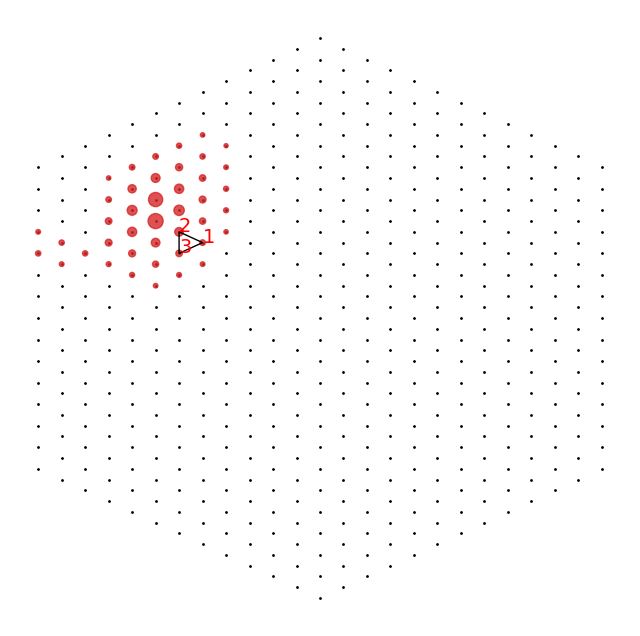

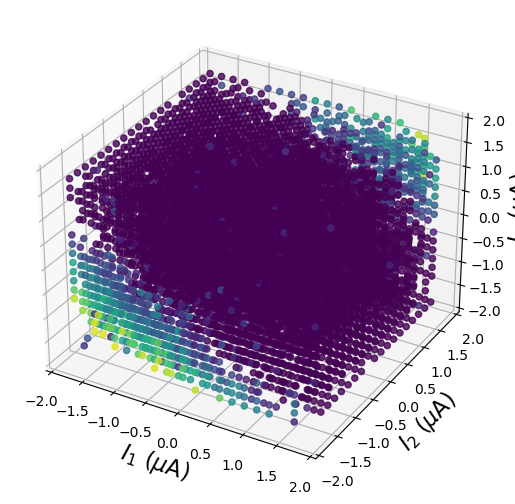

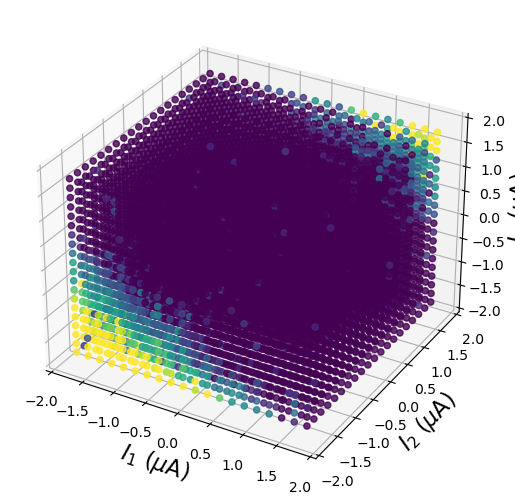

Early stopping triggered at iteration 106


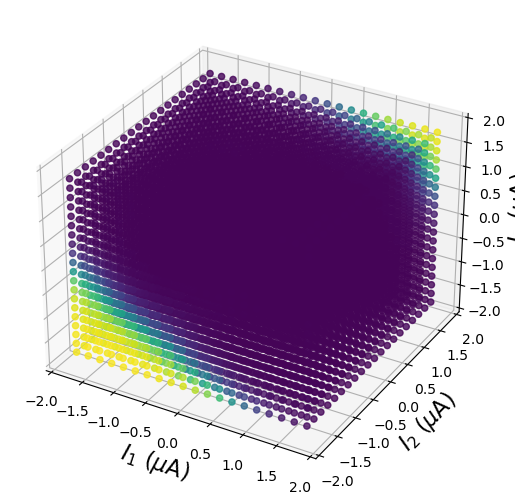

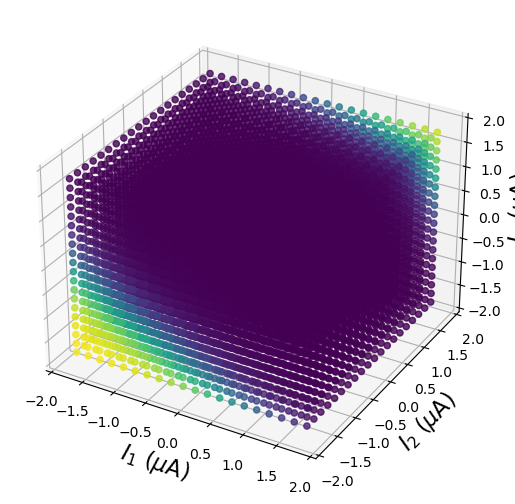

Pattern 536, cell 361
OFF parasol


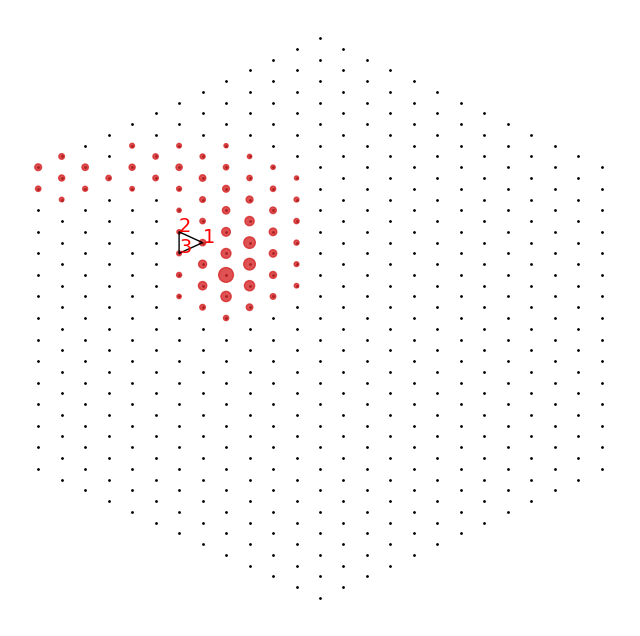

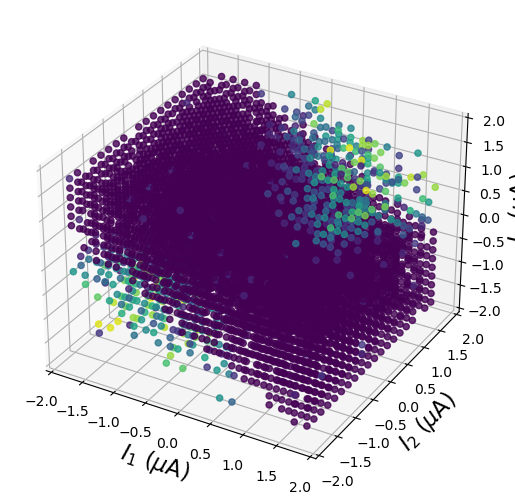

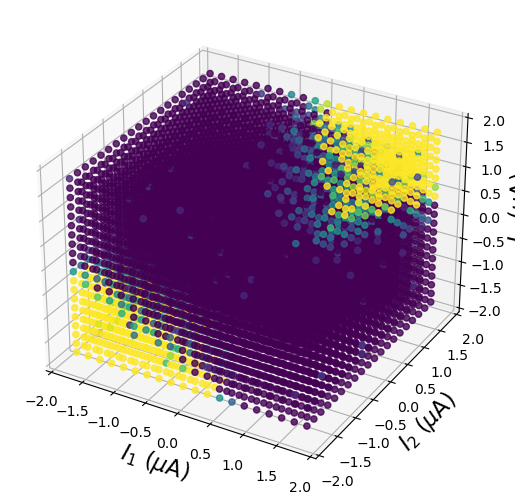

Early stopping triggered at iteration 47


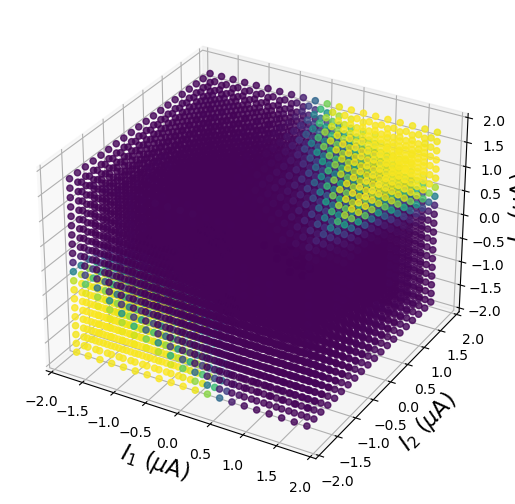

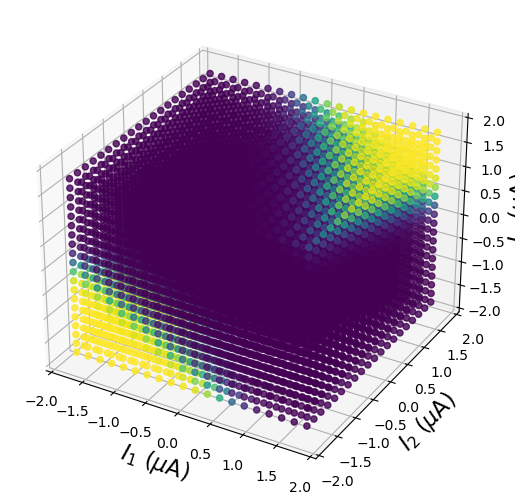

Pattern 536, cell 316
OFF parasol


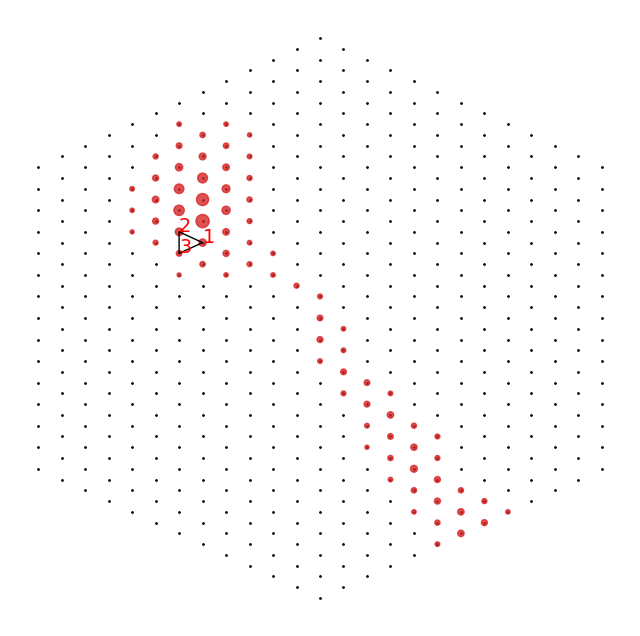

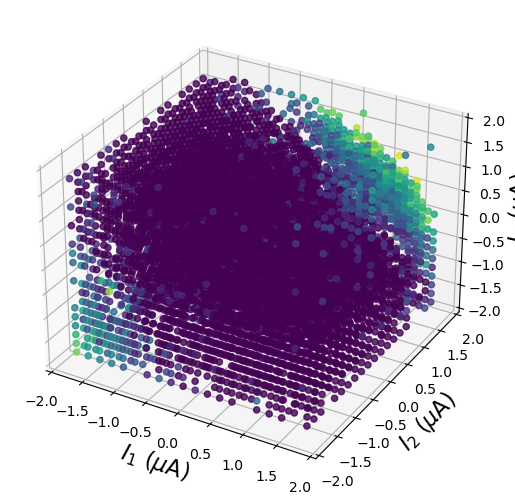

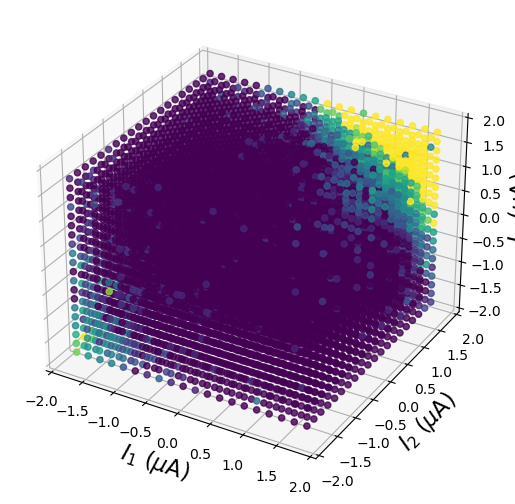

Early stopping triggered at iteration 49


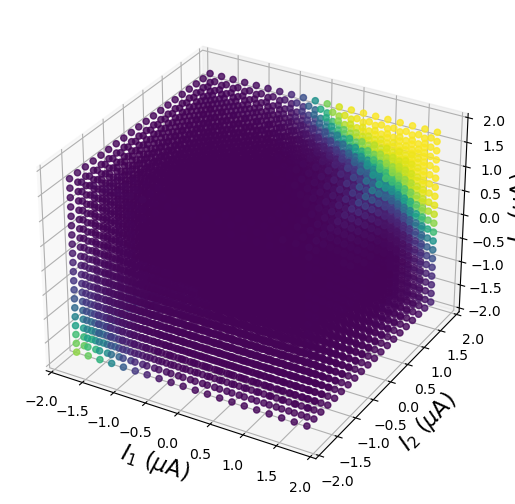

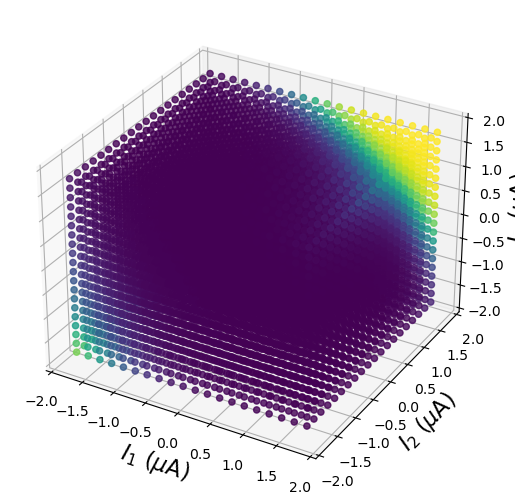

Pattern 536, cell 752
OFF parasol


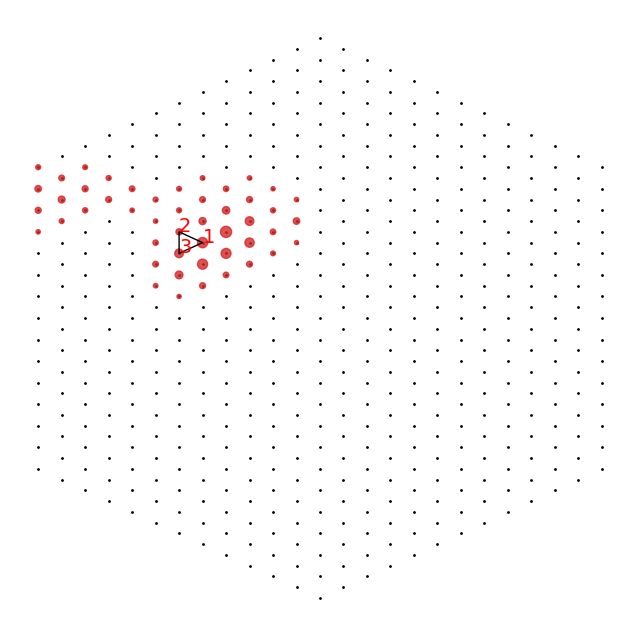

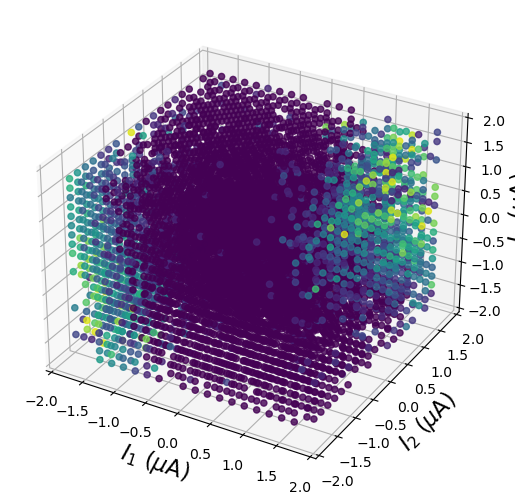

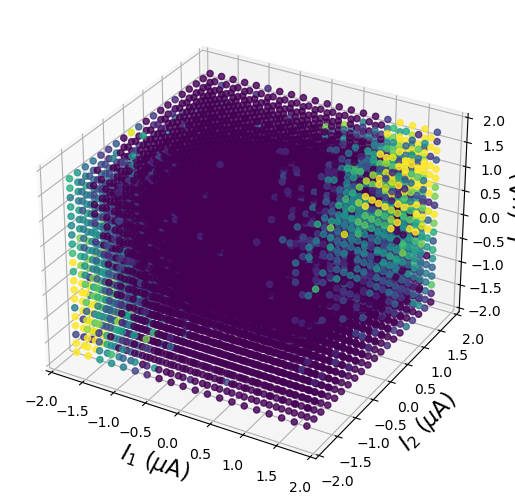

Early stopping triggered at iteration 73


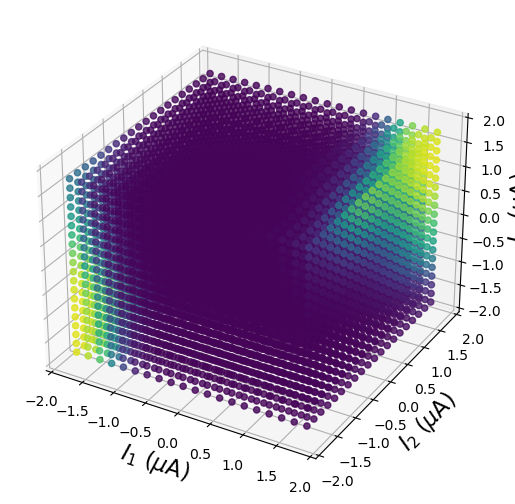

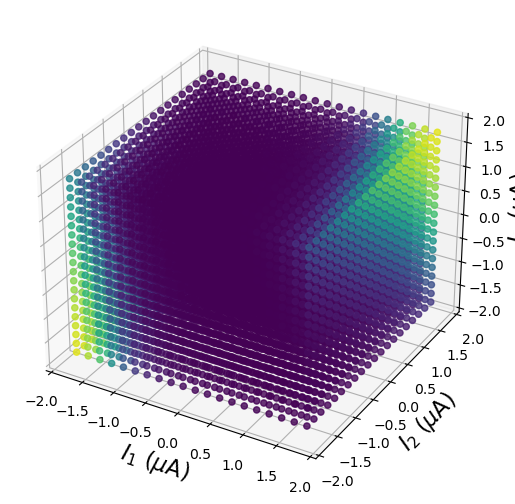

Pattern 536, cell 346
OFF parasol


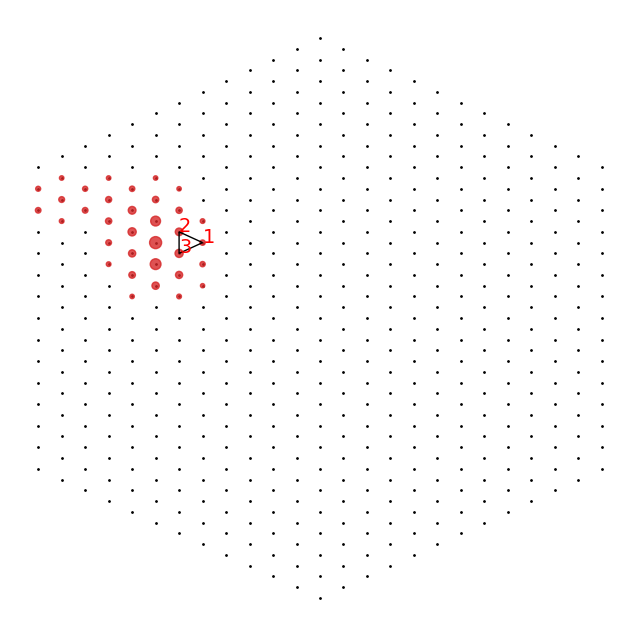

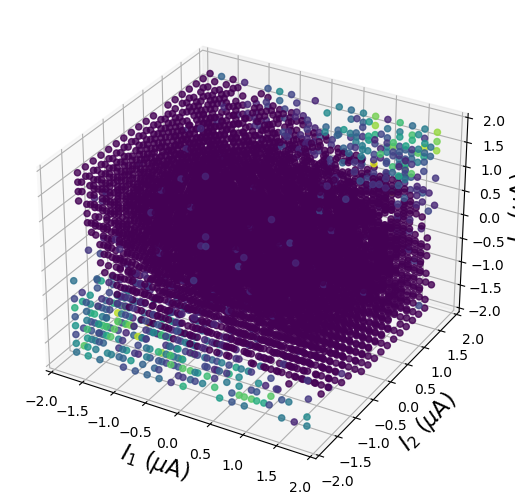

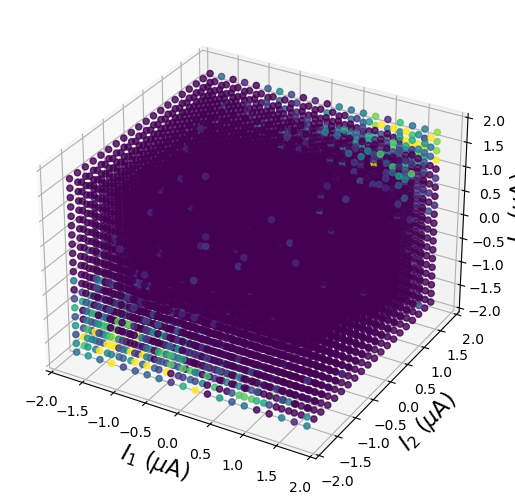

Early stopping triggered at iteration 53


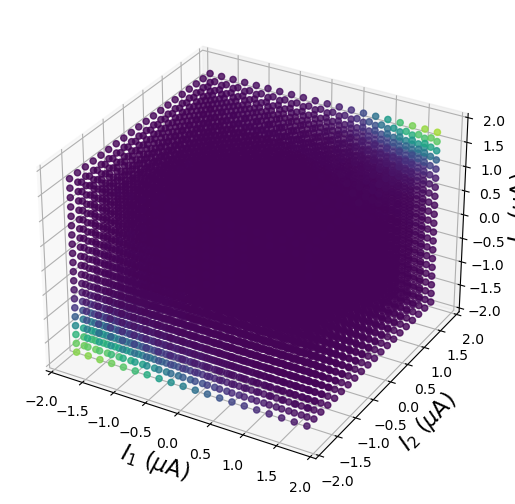

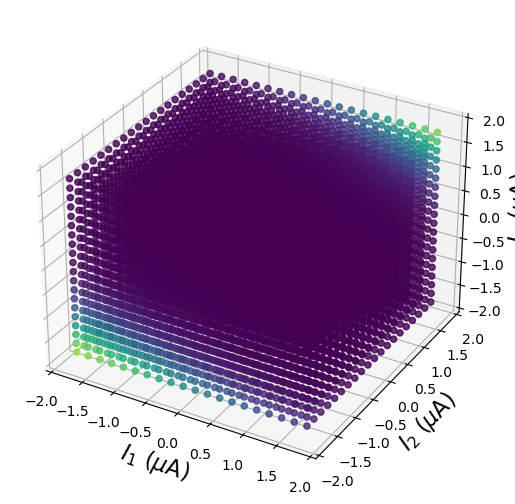

Processing 2020-09-29-2 data008 kilosort_data006/data006
Pattern 311, cell 219
ON parasol


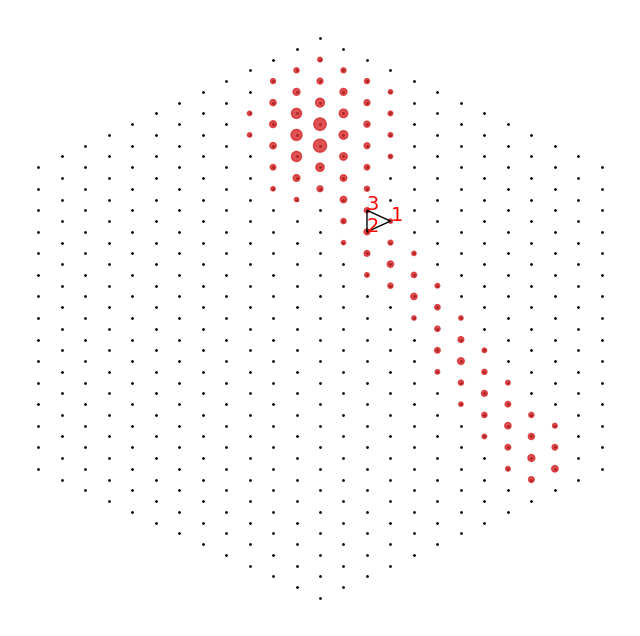

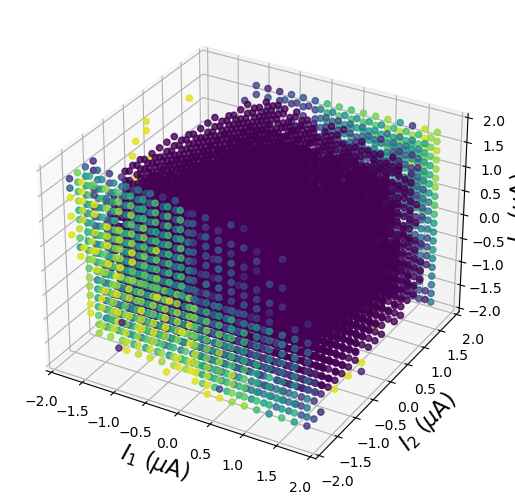

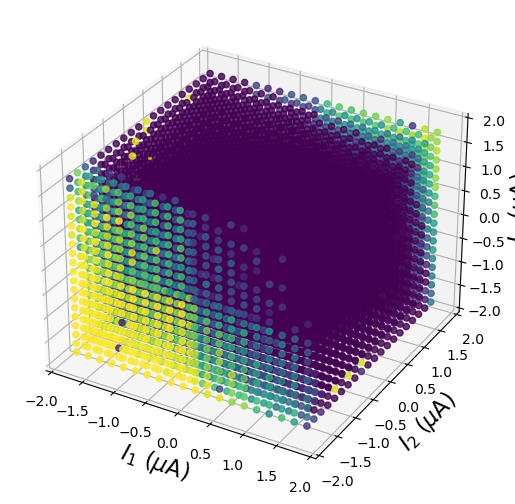

Early stopping triggered at iteration 120


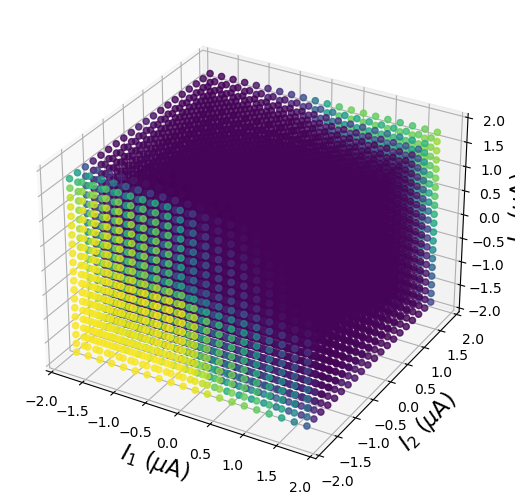

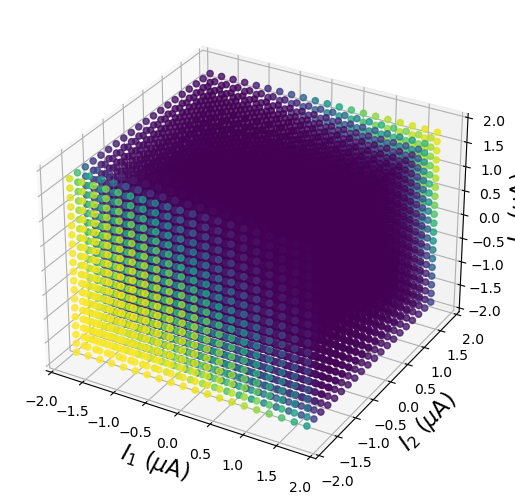

Pattern 311, cell 222
crap


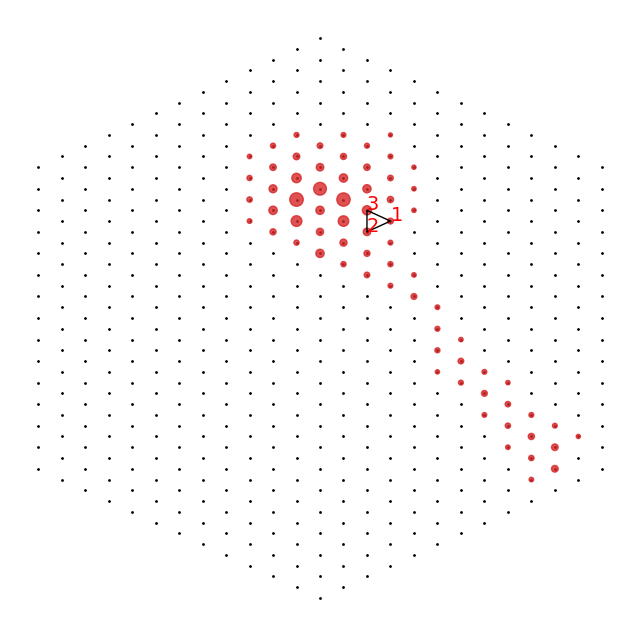

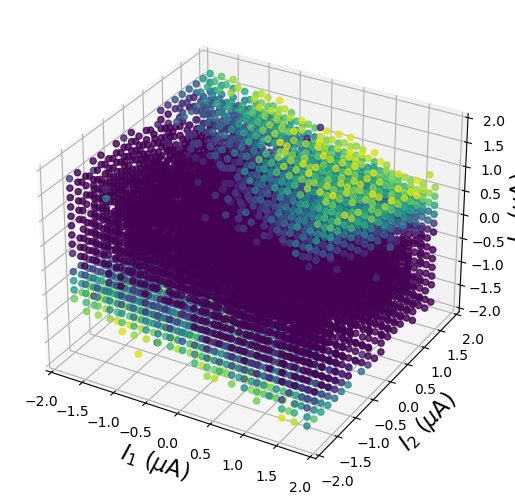

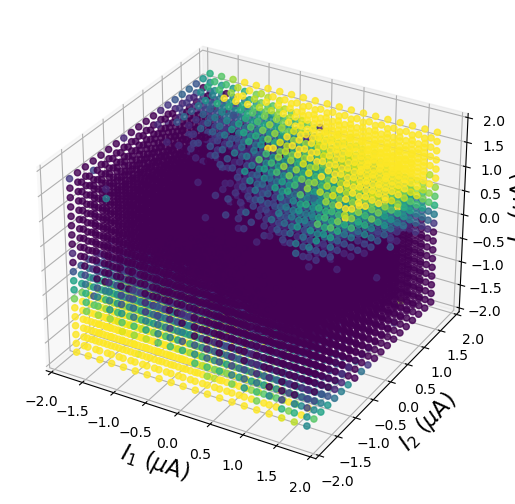

Early stopping triggered at iteration 69


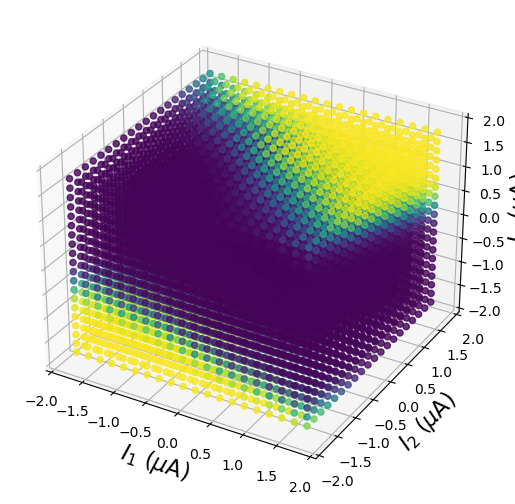

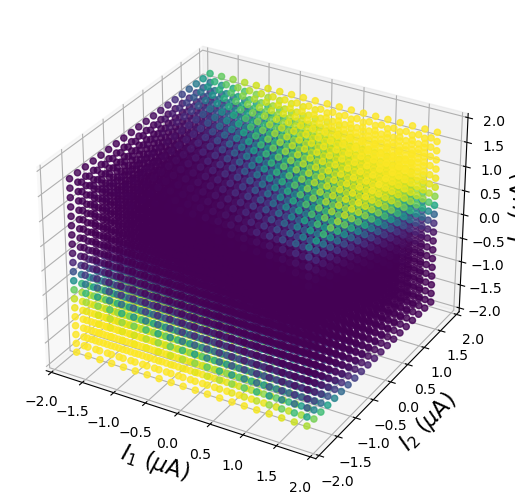

Pattern 311, cell 218
OFF parasol


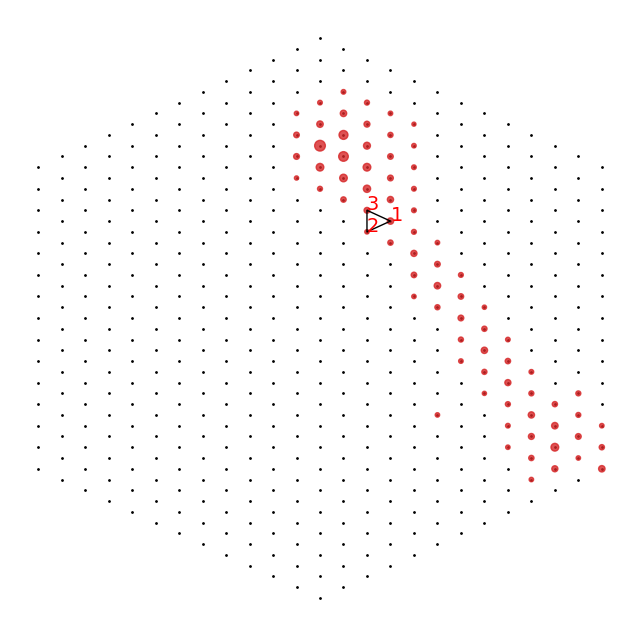

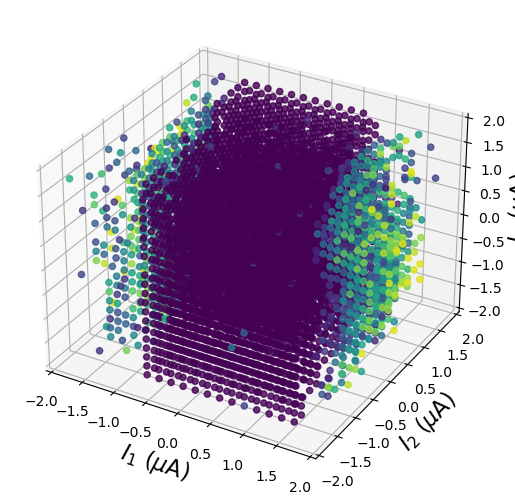

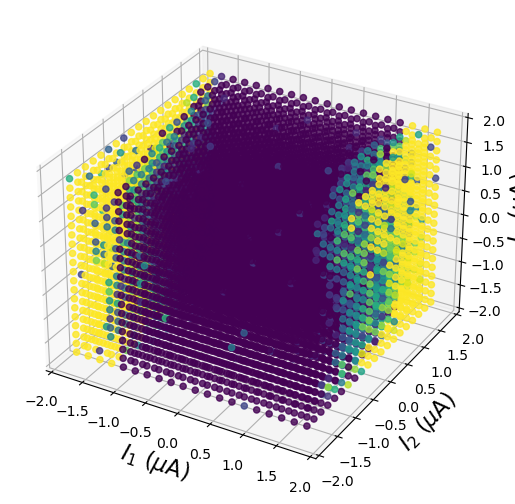

Early stopping triggered at iteration 65


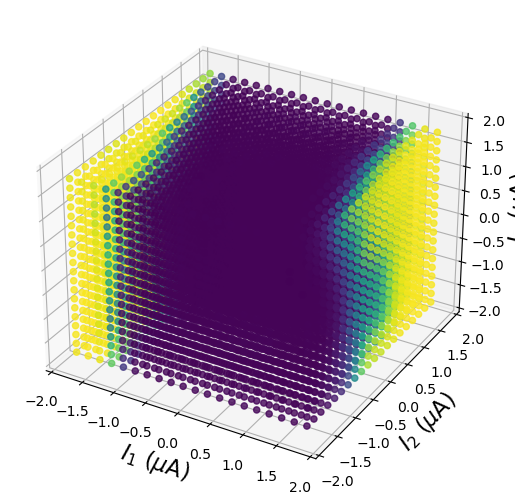

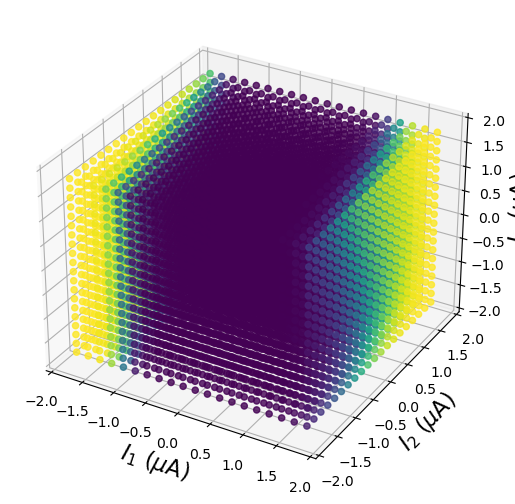

Processing 2020-09-29-2 data009 kilosort_data006/data006
Pattern 514, cell 346
OFF parasol


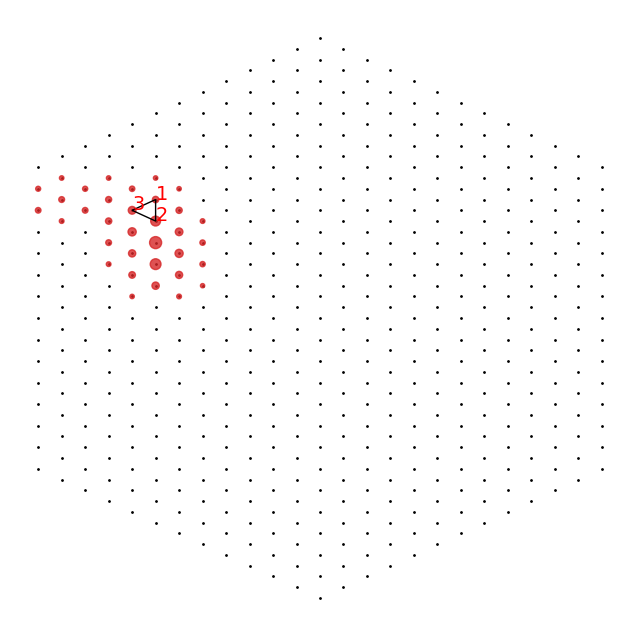

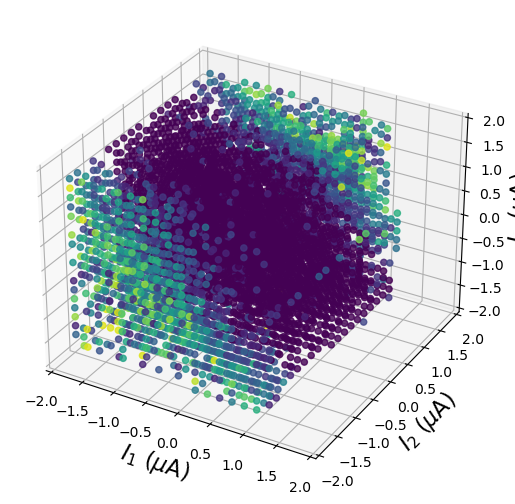

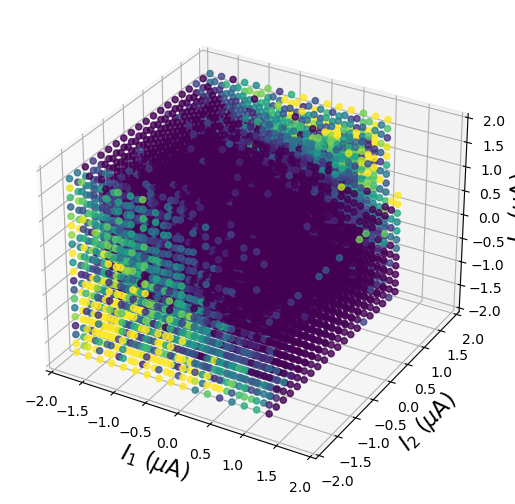

Early stopping triggered at iteration 119


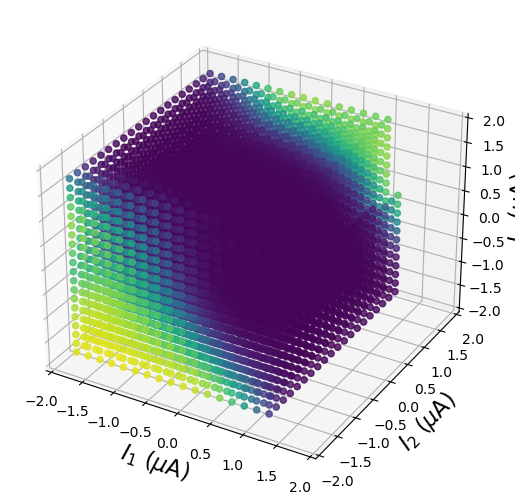

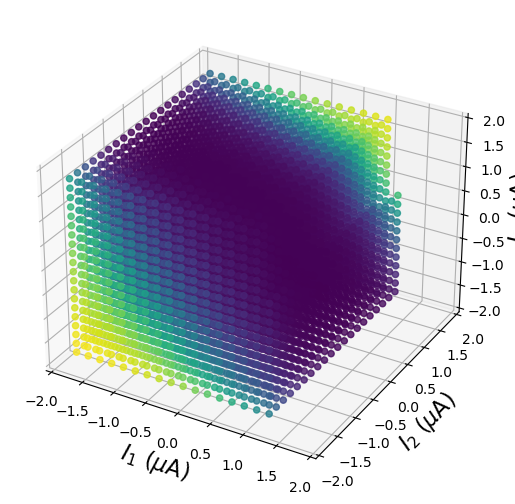

Pattern 514, cell 329
crap


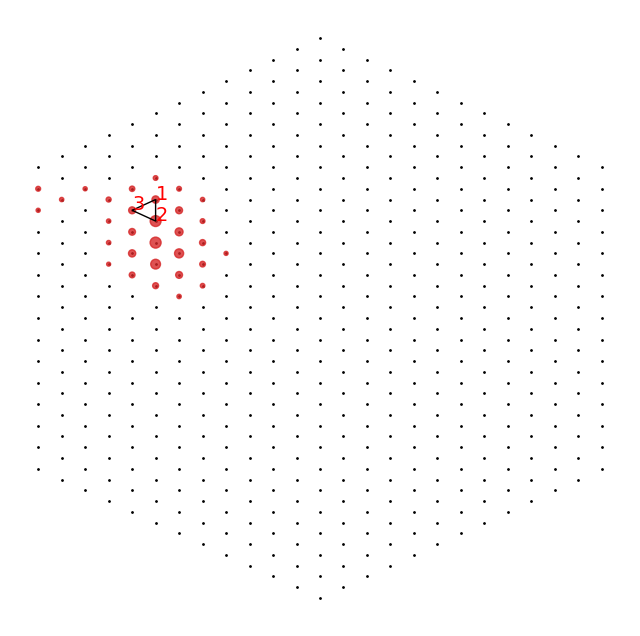

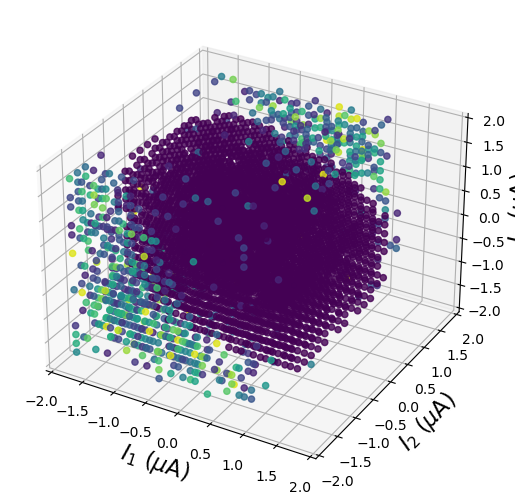

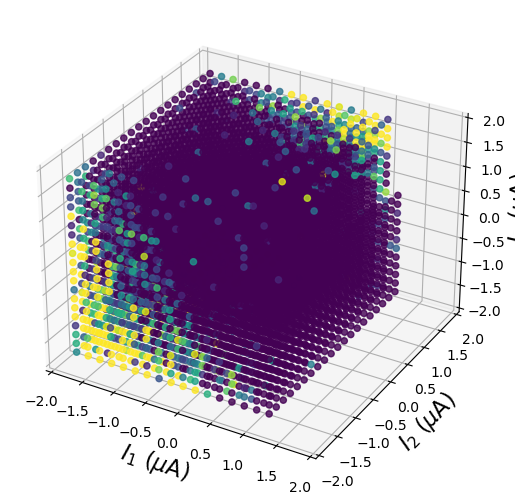

Early stopping triggered at iteration 113


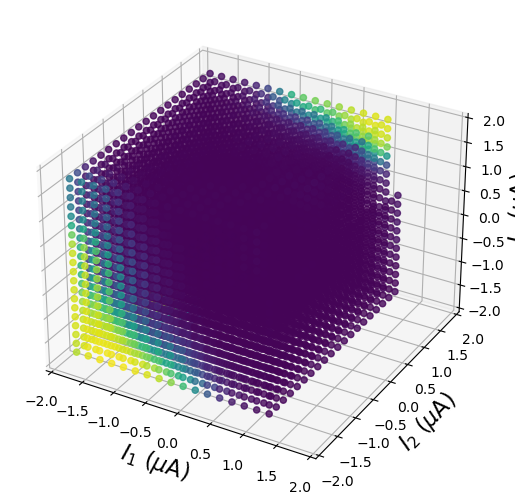

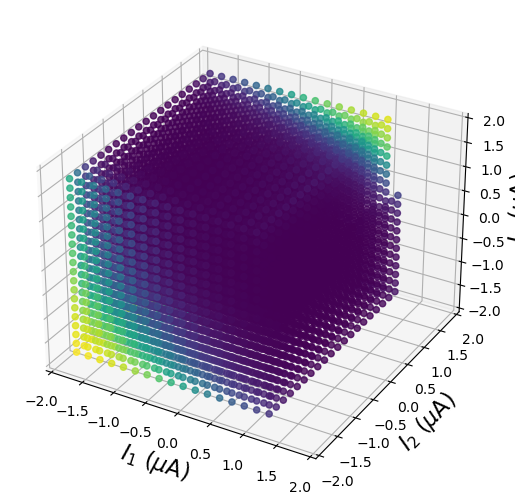

Pattern 514, cell 267
crap


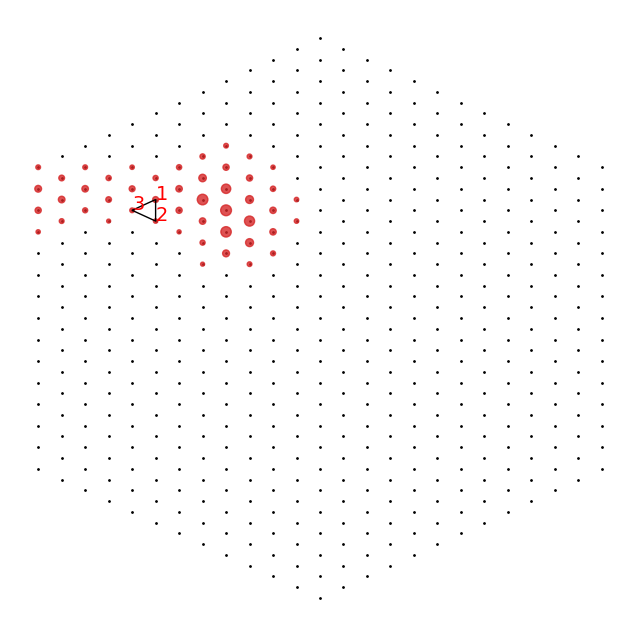

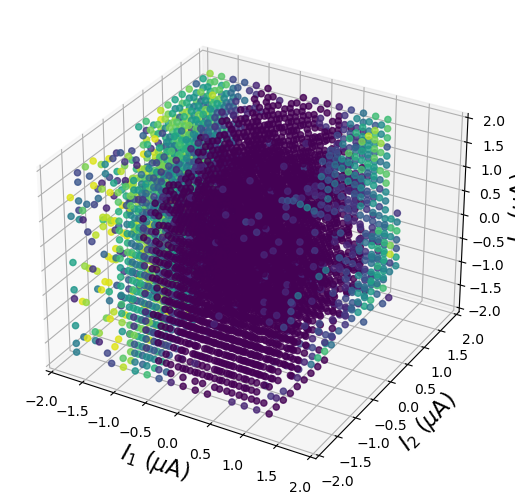

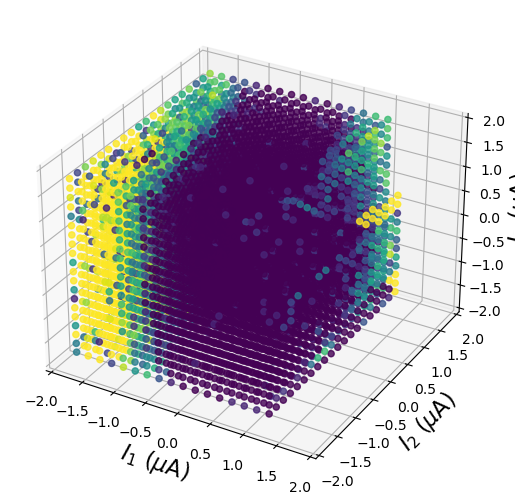

Early stopping triggered at iteration 43


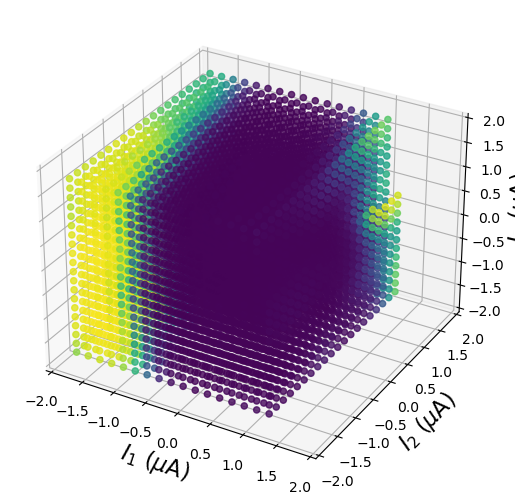

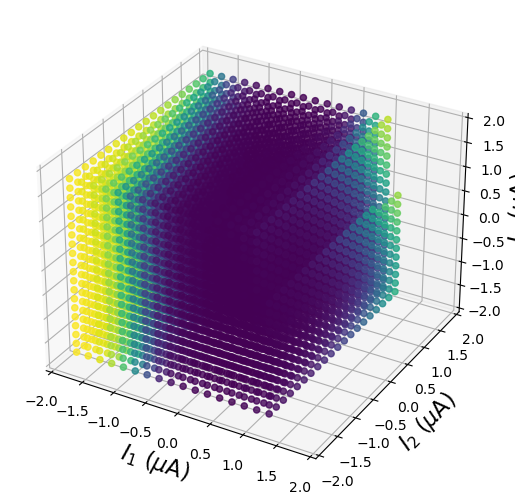

Pattern 514, cell 304
OFF parasol


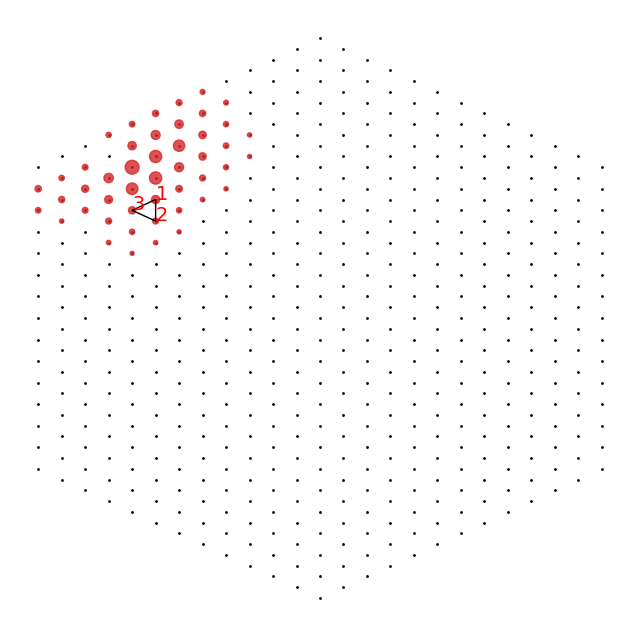

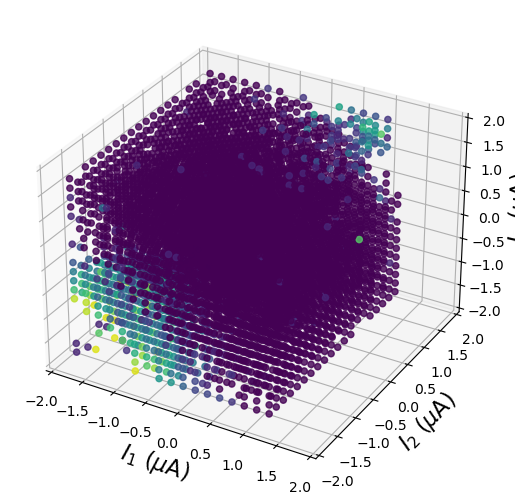

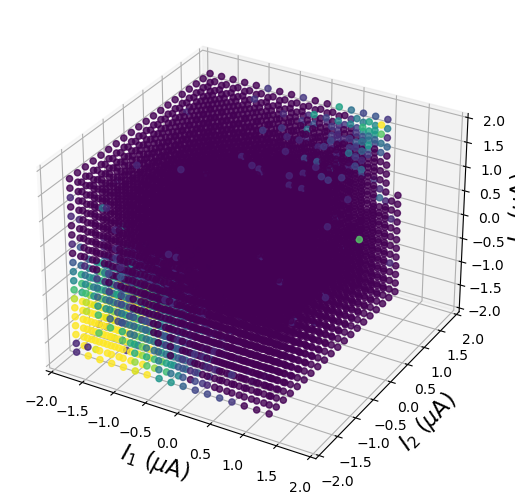

Early stopping triggered at iteration 93


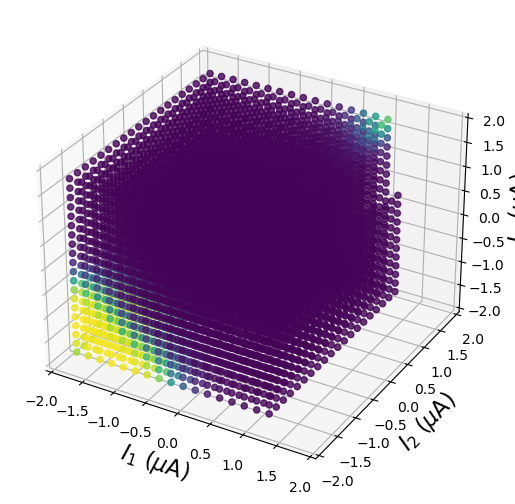

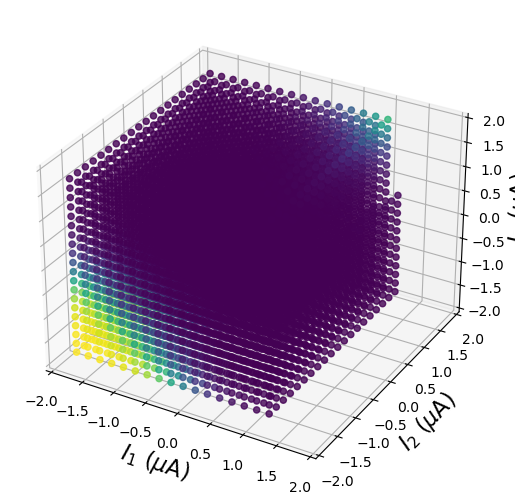

Pattern 514, cell 303
OFF parasol


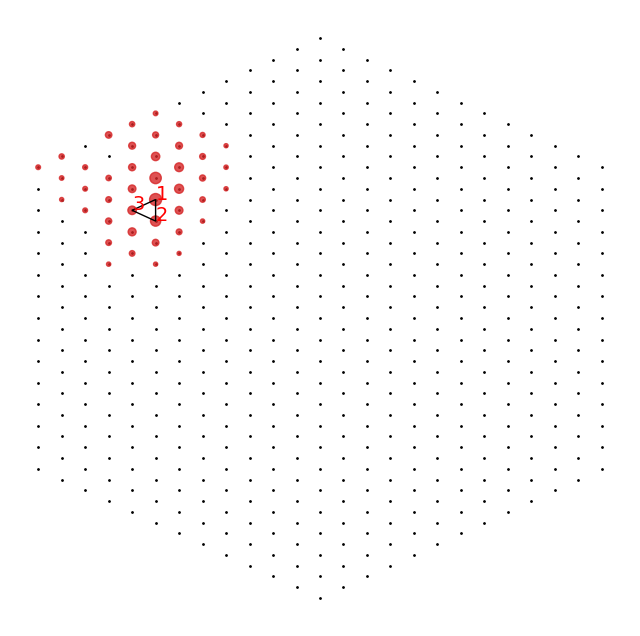

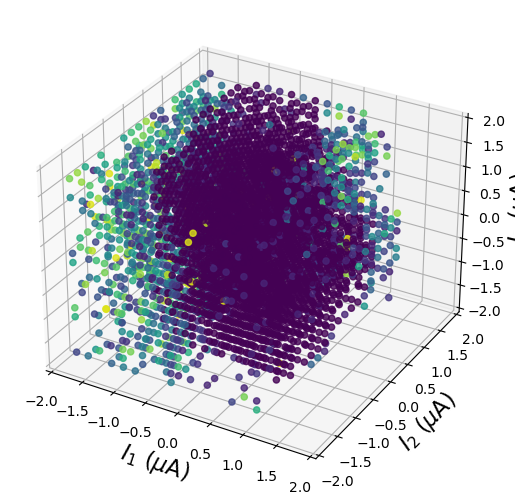

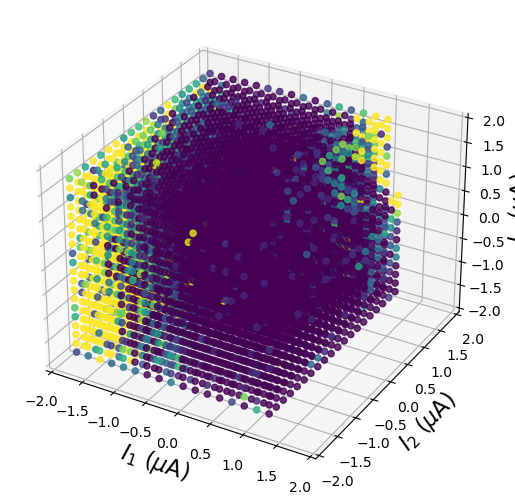

Early stopping triggered at iteration 258


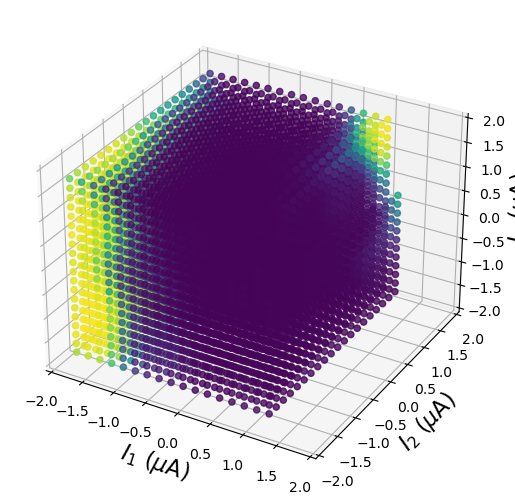

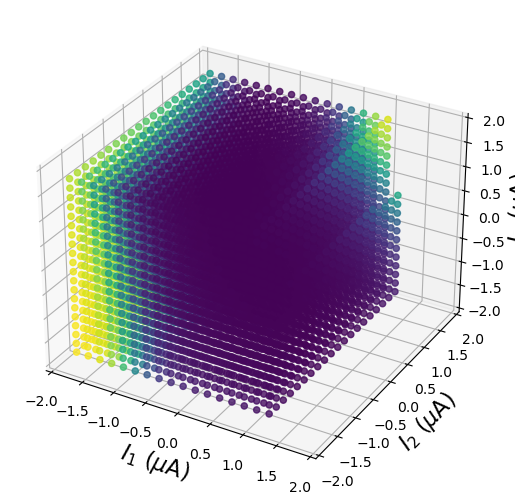

Pattern 514, cell 345
crap


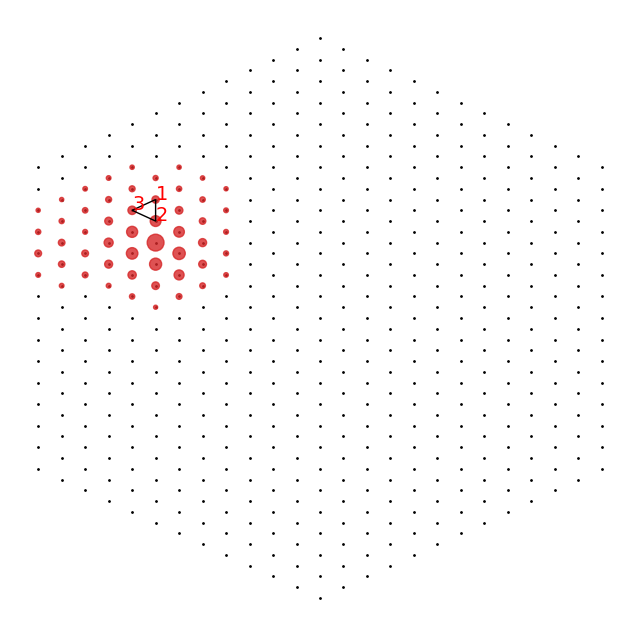

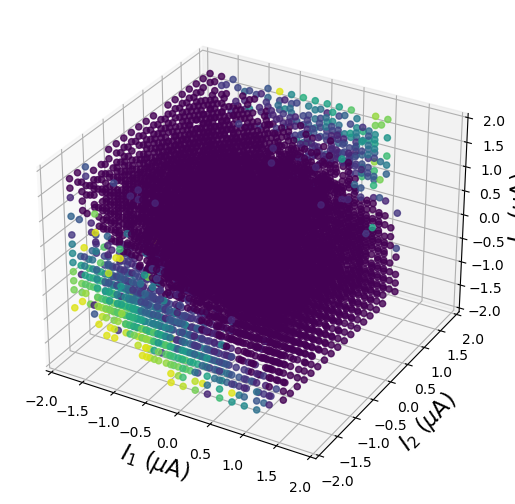

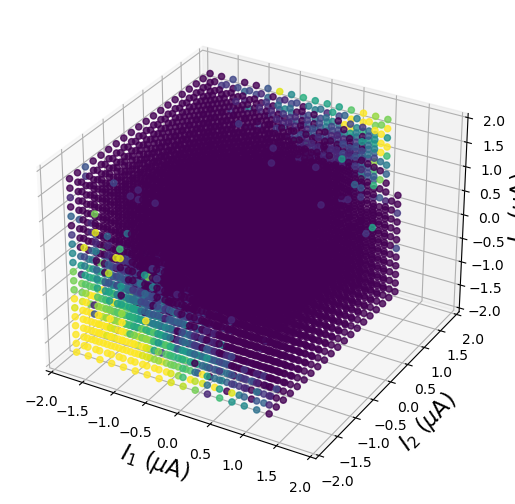

Early stopping triggered at iteration 76


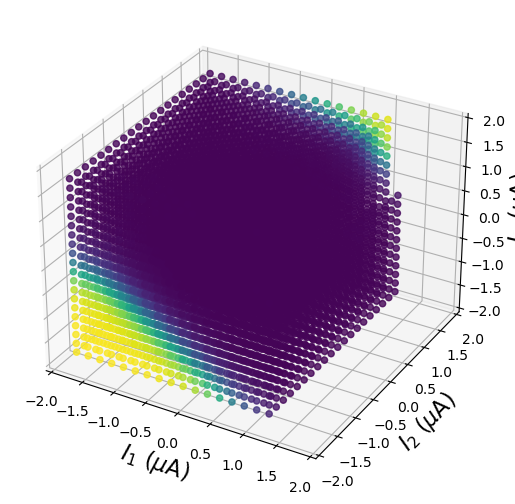

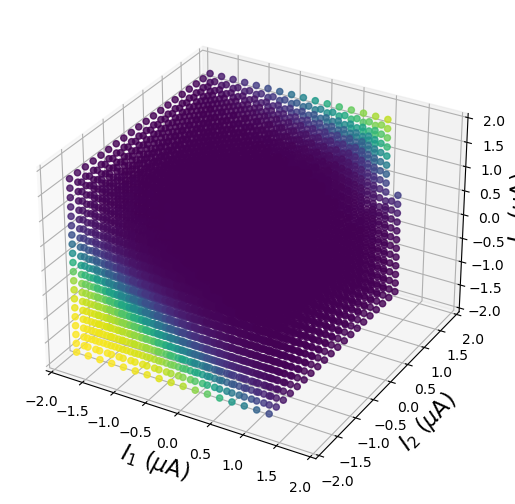

Pattern 514, cell 268
crap


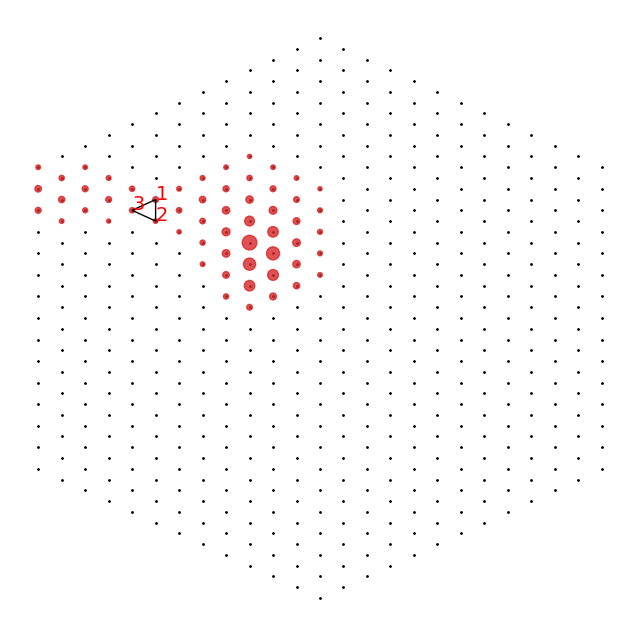

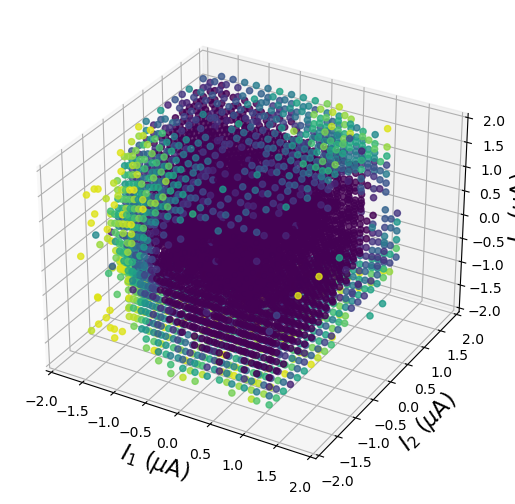

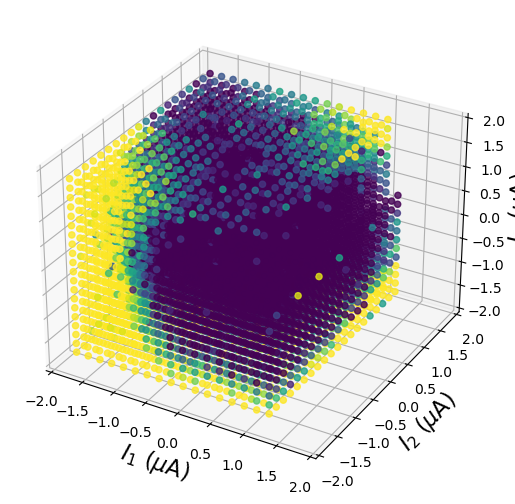

Early stopping triggered at iteration 42


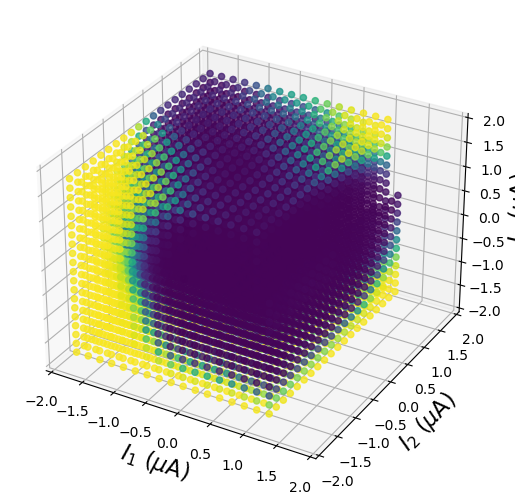

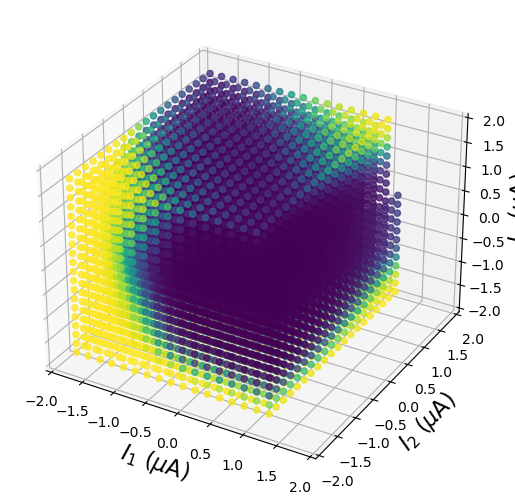

Pattern 514, cell 330
crap


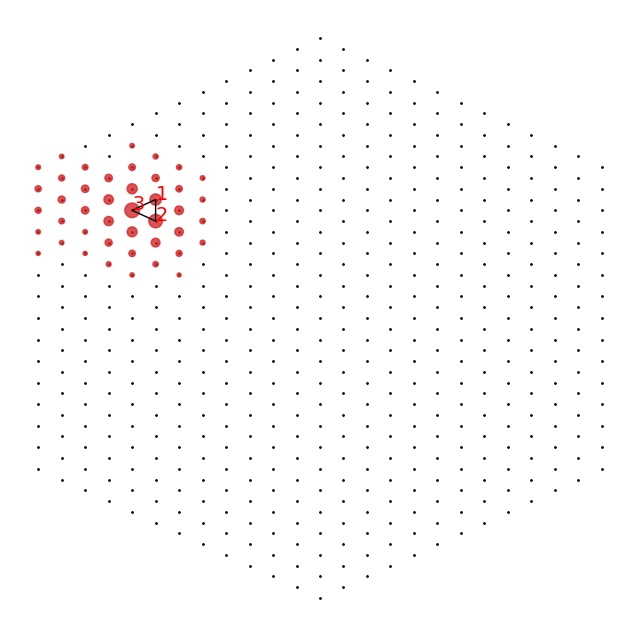

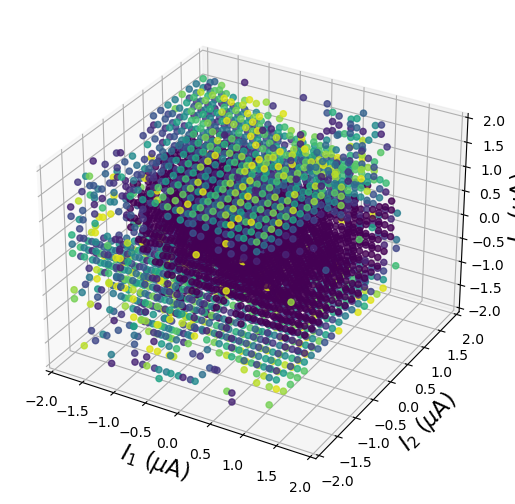

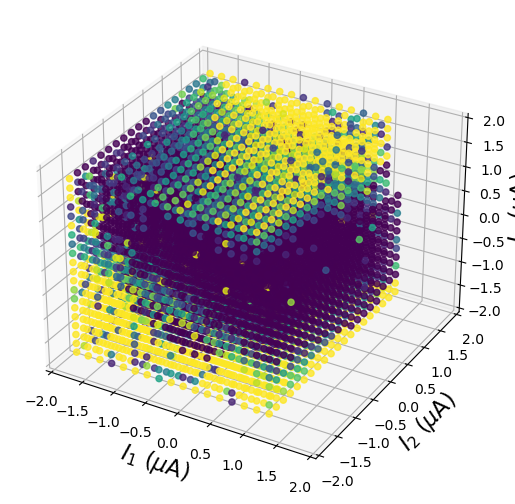

Early stopping triggered at iteration 258


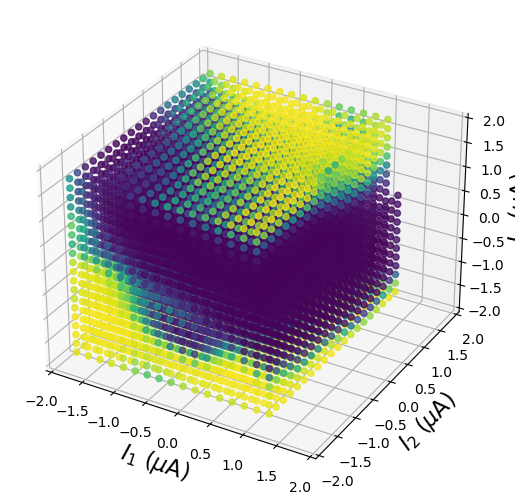

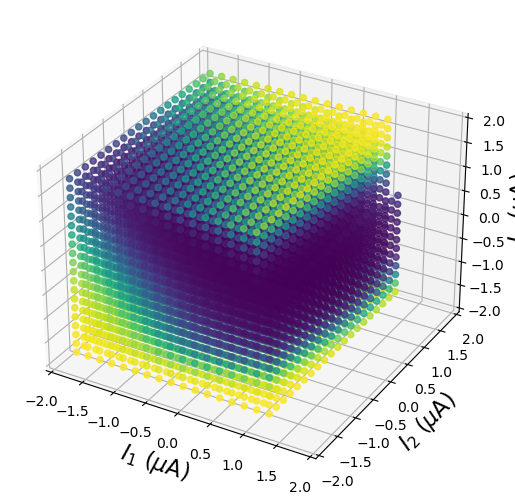

Processing 2020-10-06-7 data003 kilosort_data000/data000
Pattern 100, cell 244
ON parasol


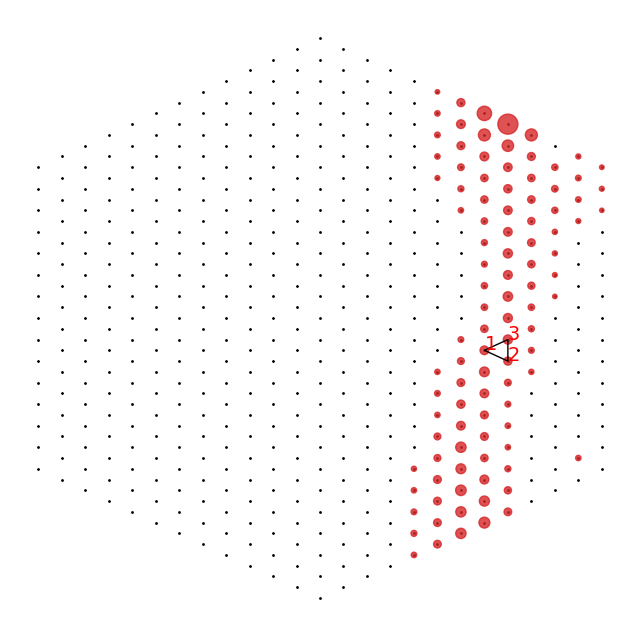

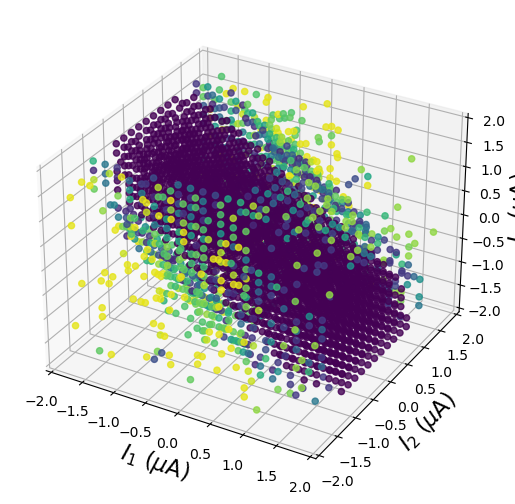

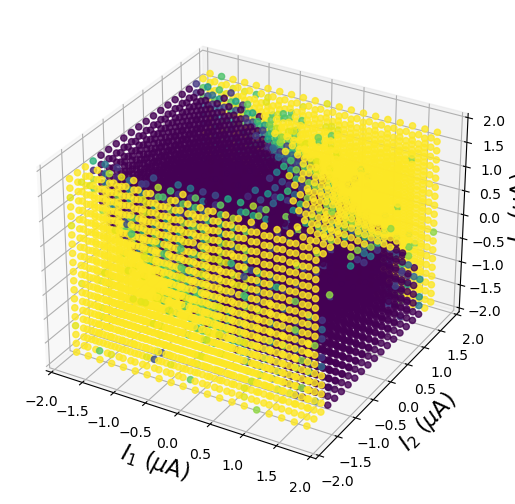

Early stopping triggered at iteration 163


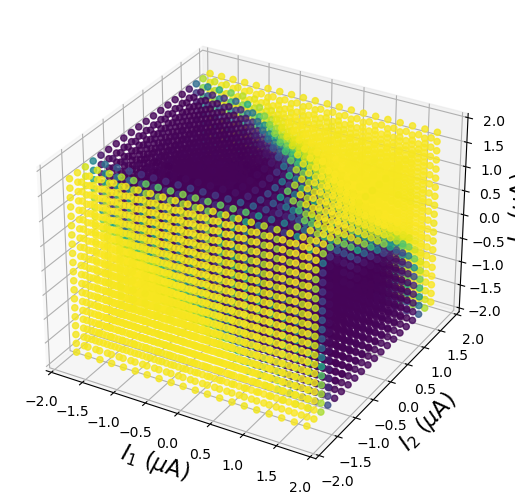

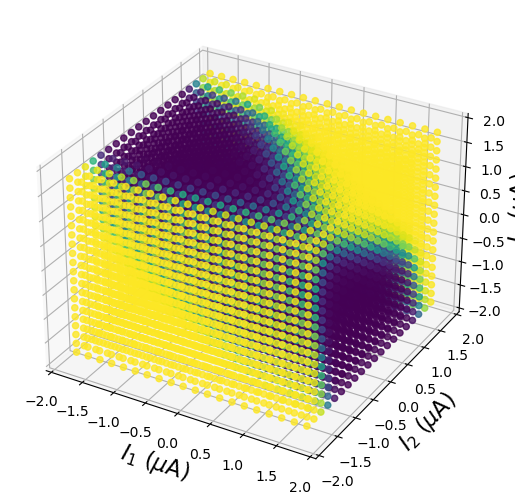

Pattern 398, cell 301
OFF parasol


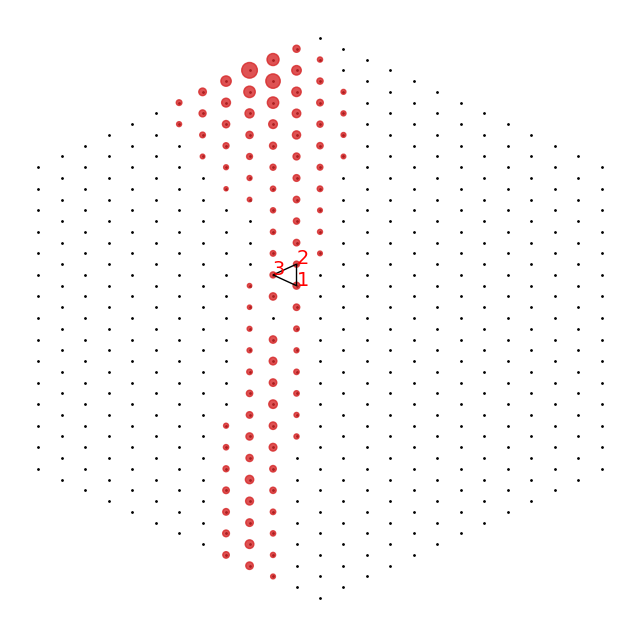

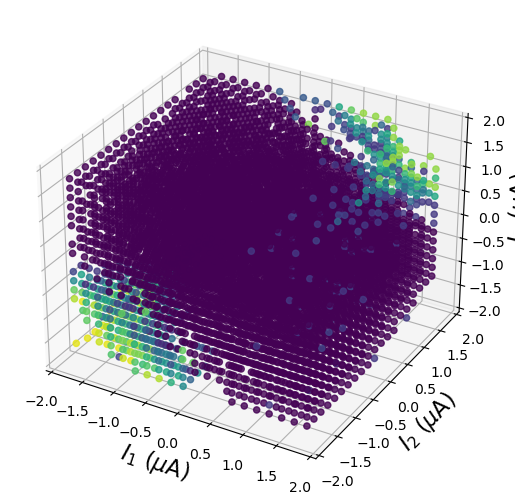

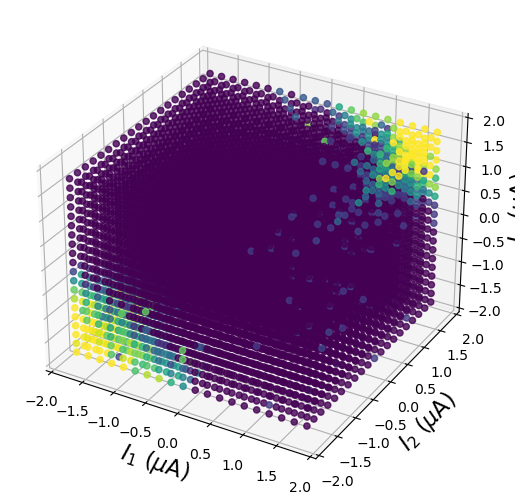

Early stopping triggered at iteration 111


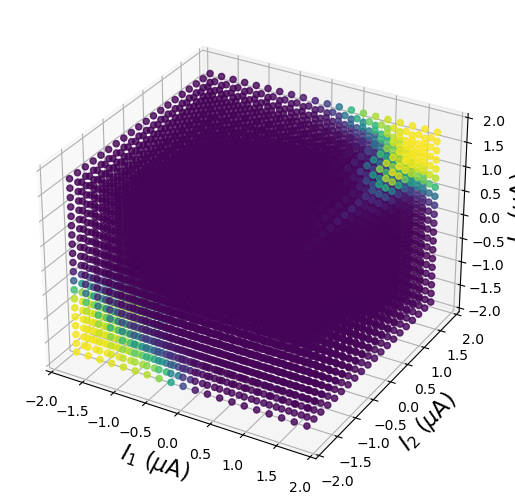

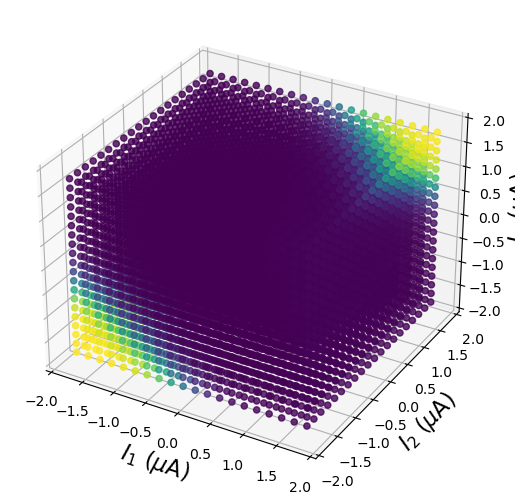

Pattern 100, cell 84
ON parasol


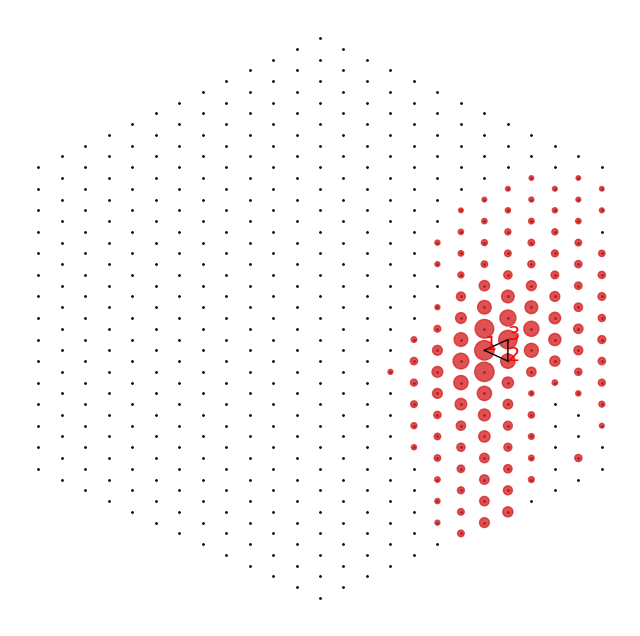

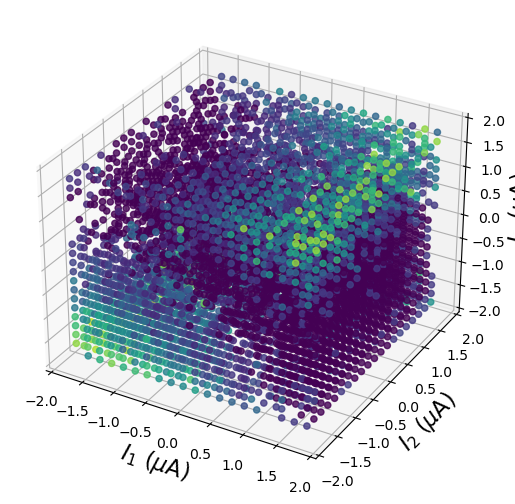

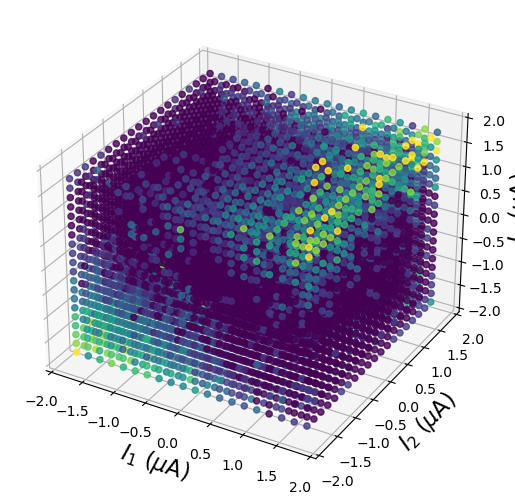

Early stopping triggered at iteration 77


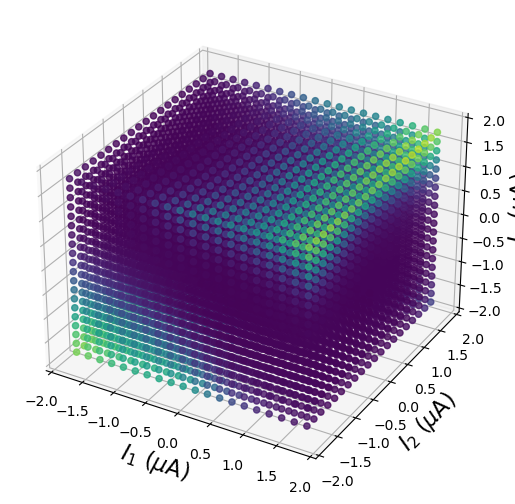

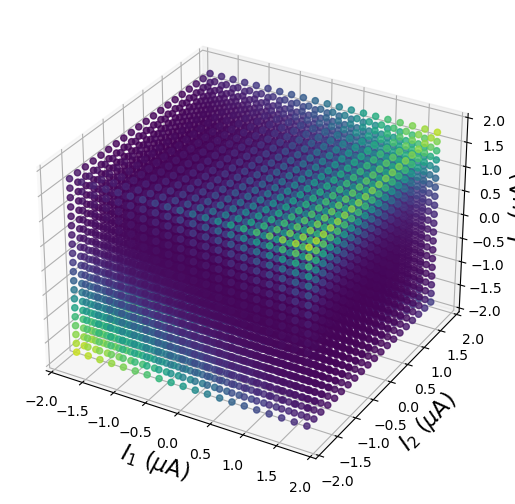

Pattern 398, cell 296
OFF parasol


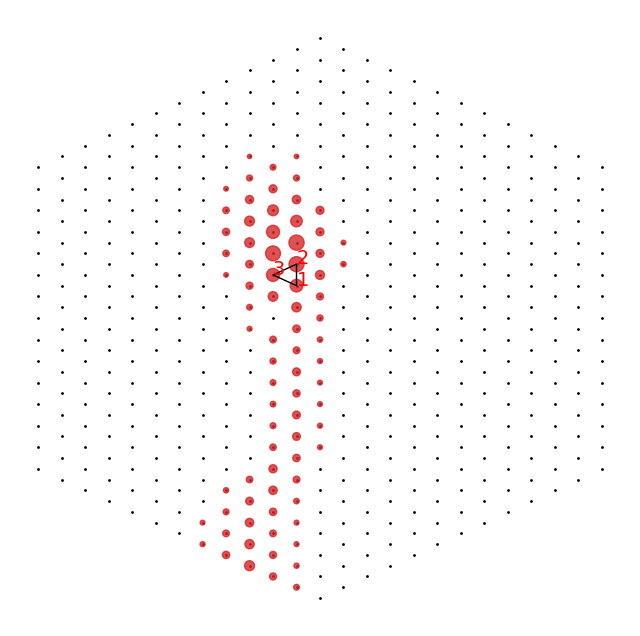

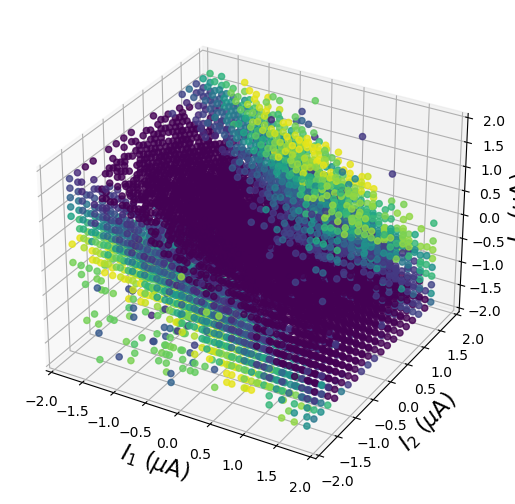

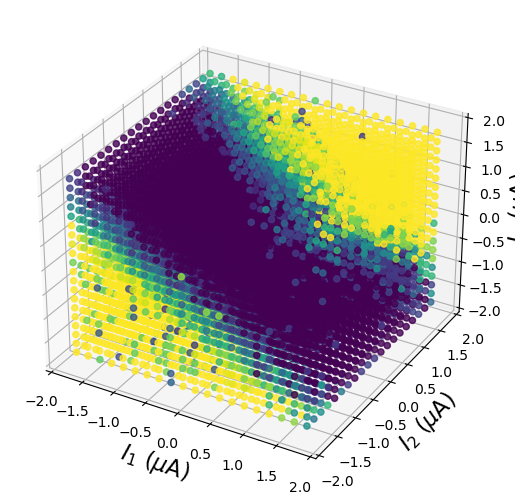

Early stopping triggered at iteration 53


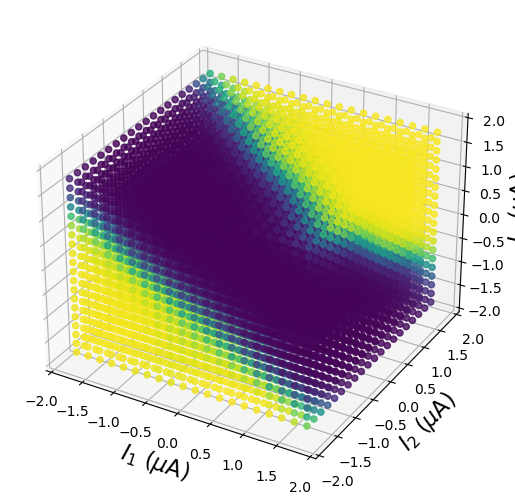

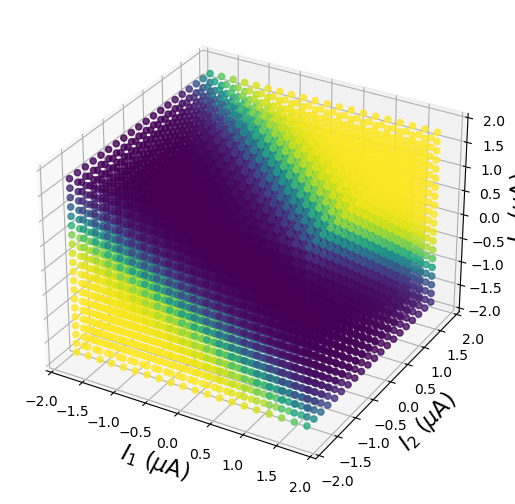

Processing 2020-10-18-0 data003 kilosort_data000/data000
Pattern 233, cell 81
ON parasol


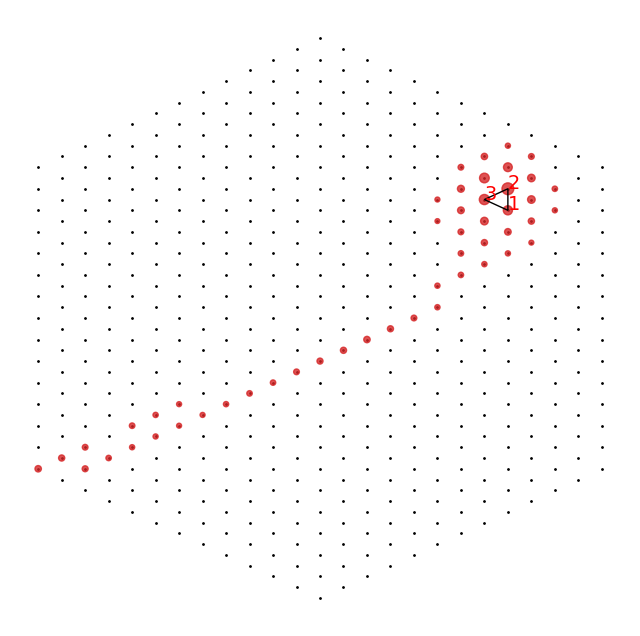

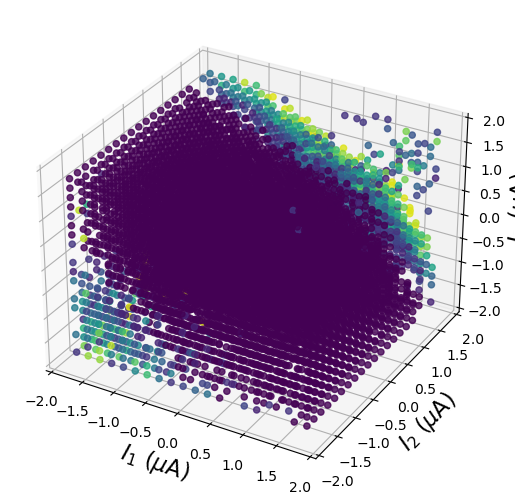

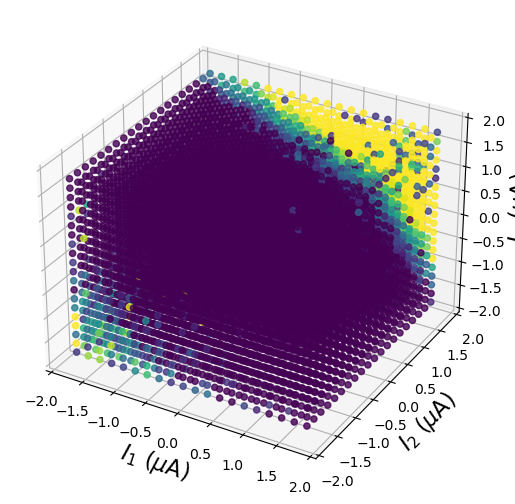

Early stopping triggered at iteration 47


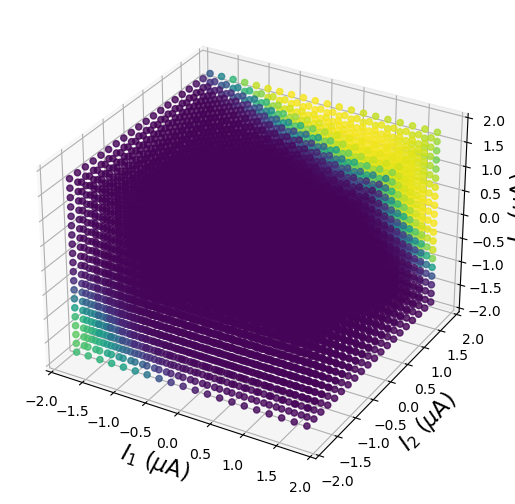

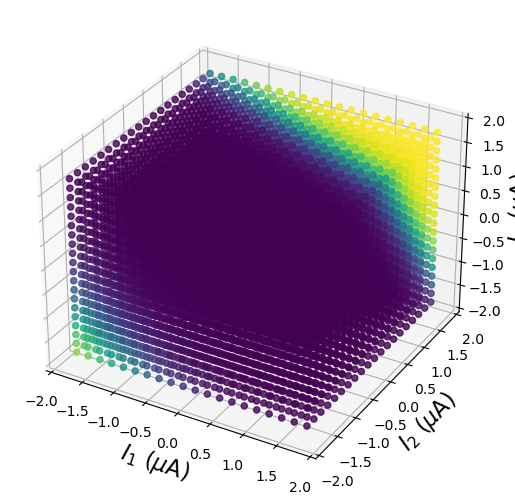

Pattern 233, cell 74
OFF parasol


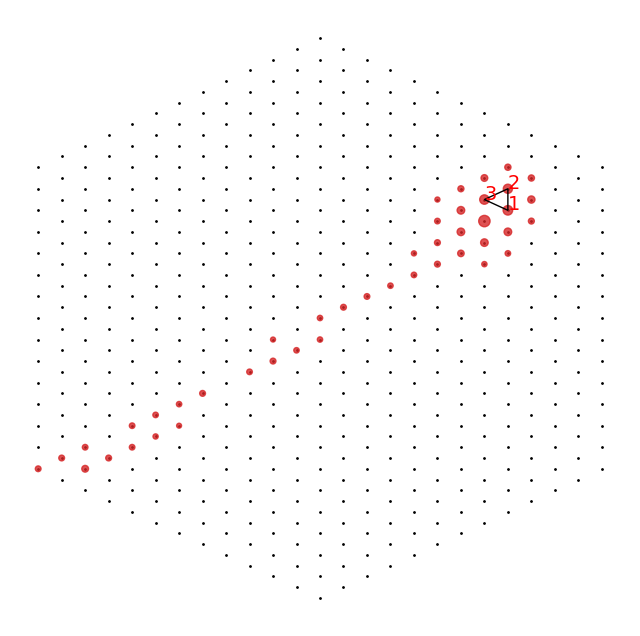

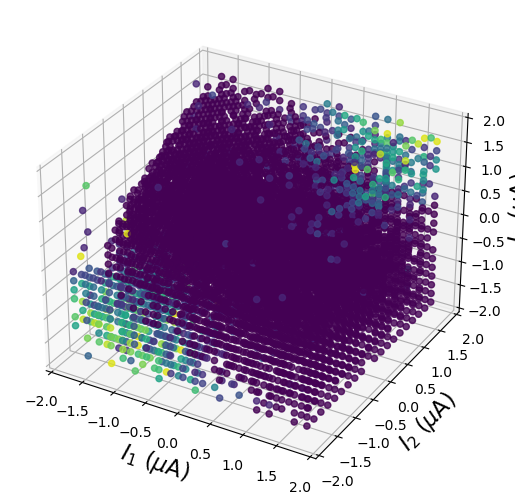

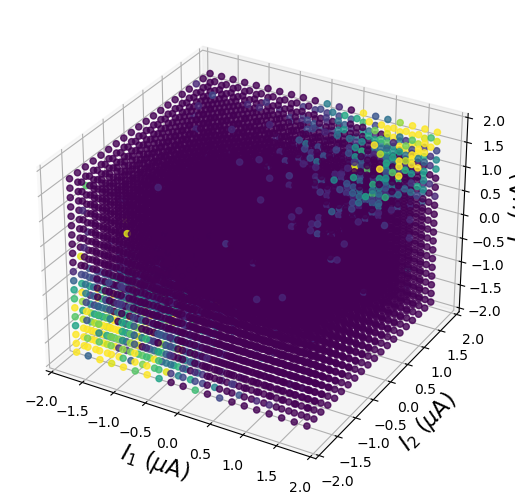

Early stopping triggered at iteration 59


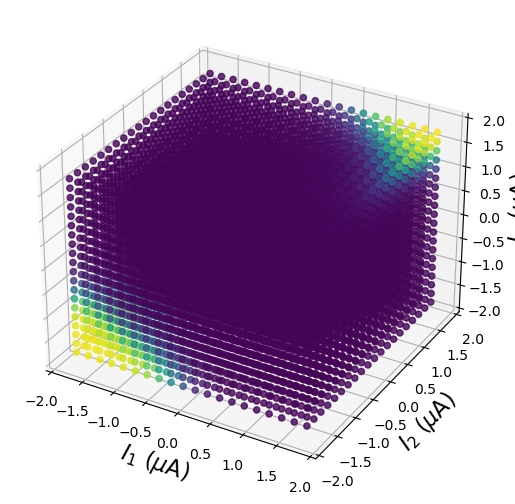

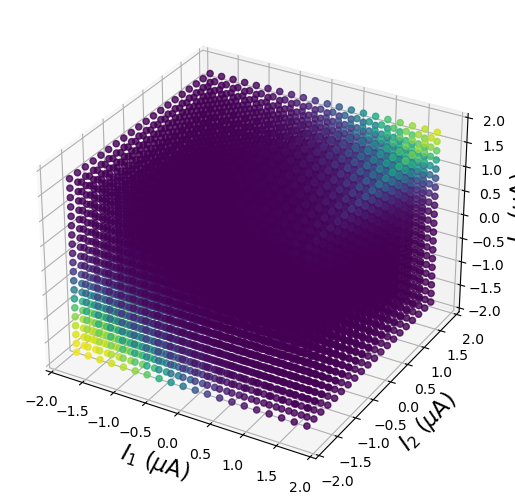

Pattern 233, cell 72
OFF parasol


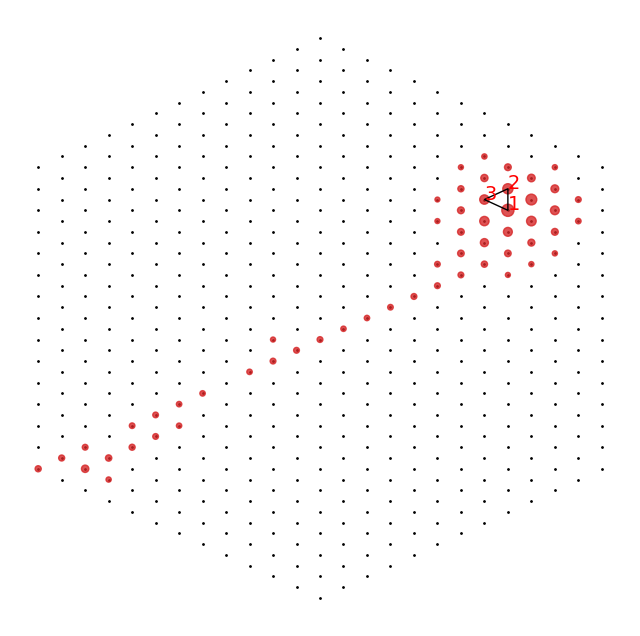

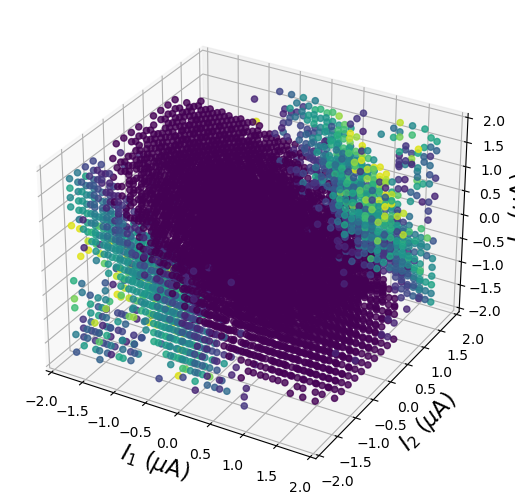

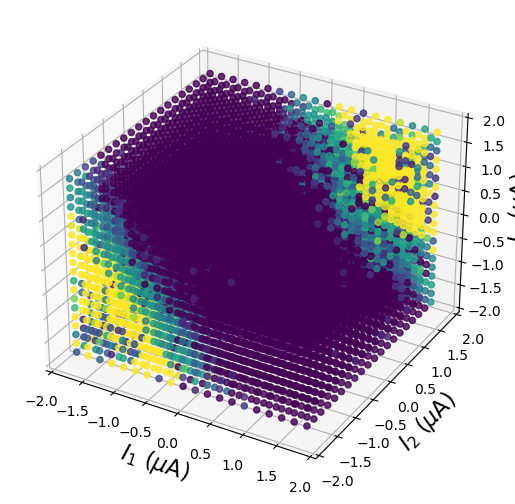

Early stopping triggered at iteration 80


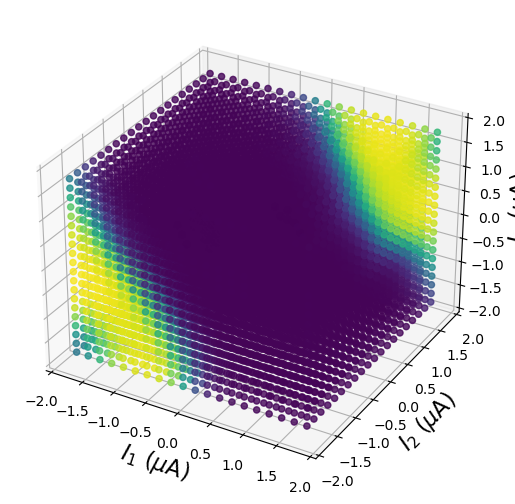

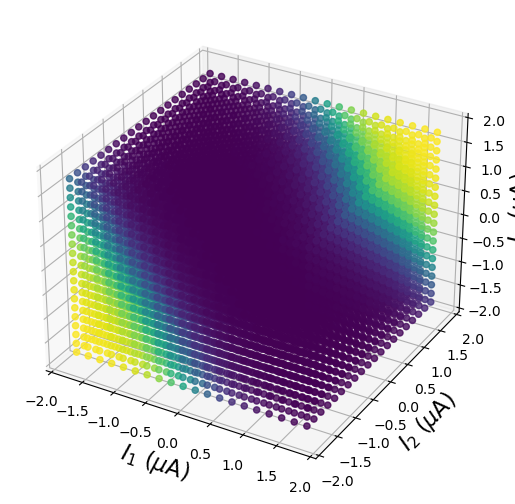

Pattern 233, cell 85
OFF parasol


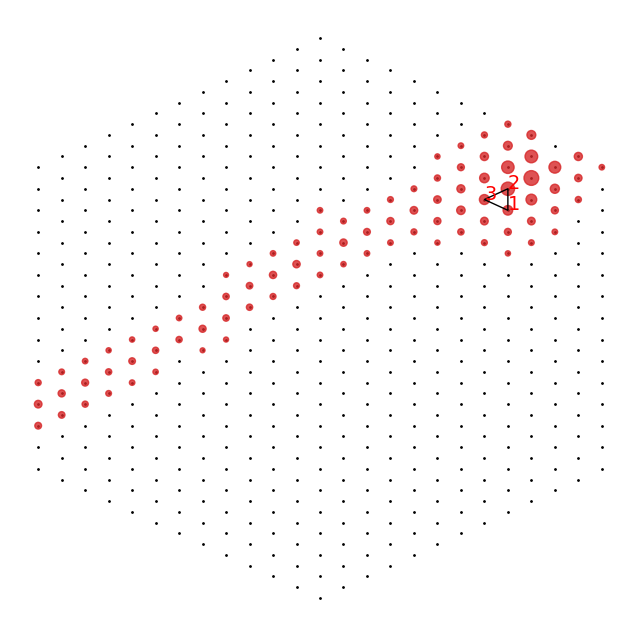

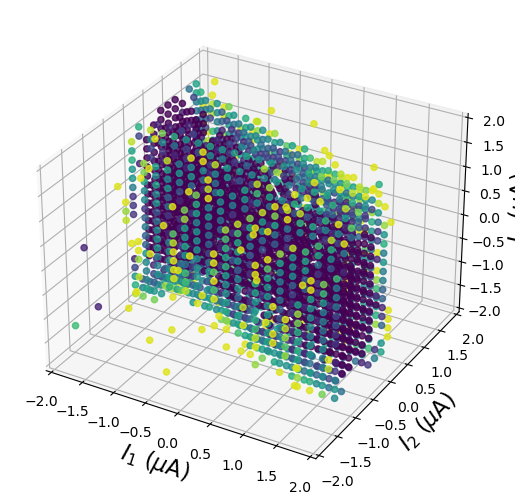

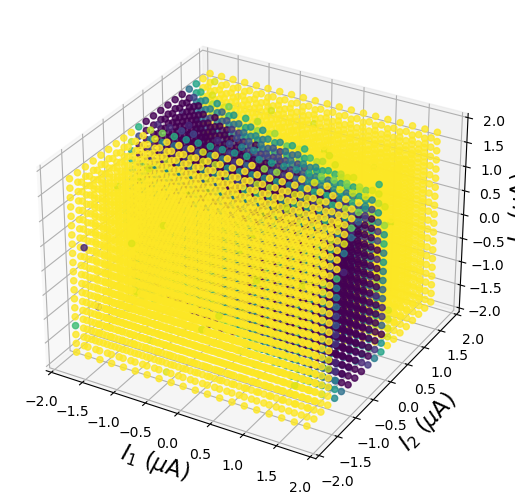

Early stopping triggered at iteration 123


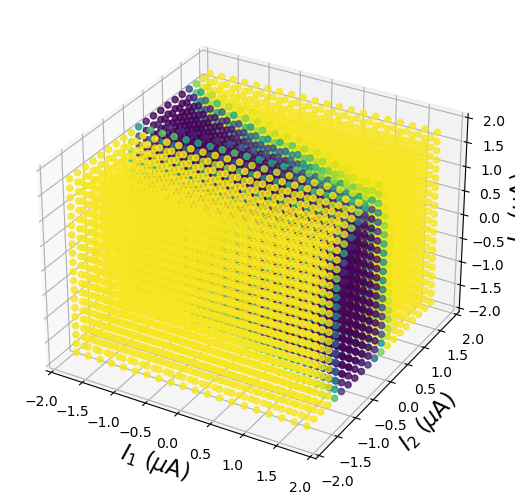

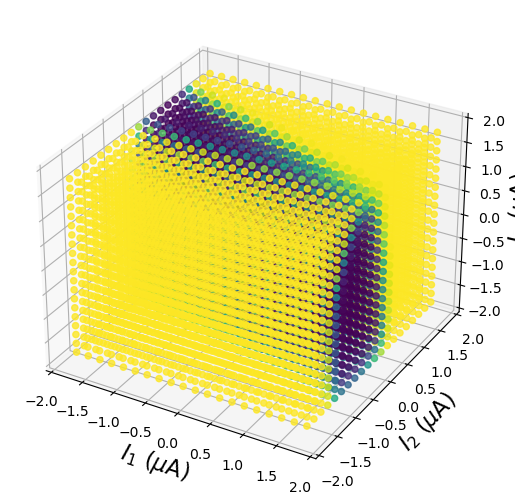

Pattern 233, cell 82
SBCs


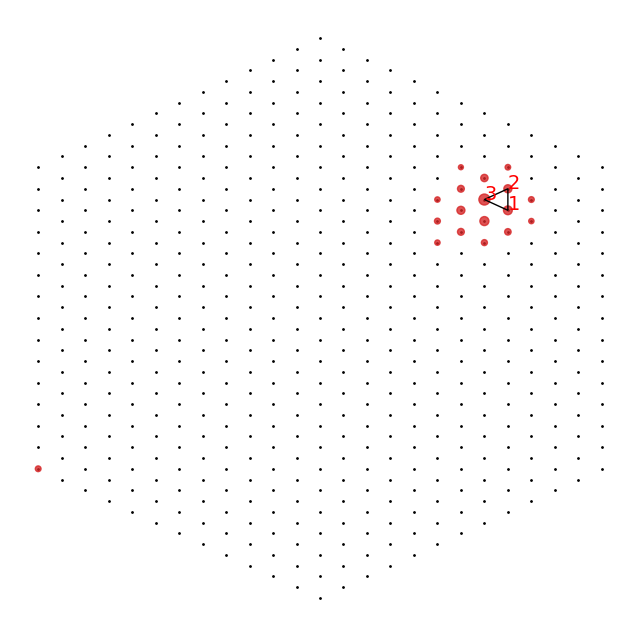

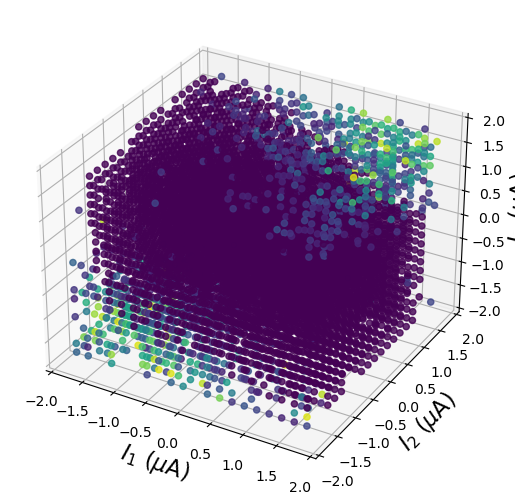

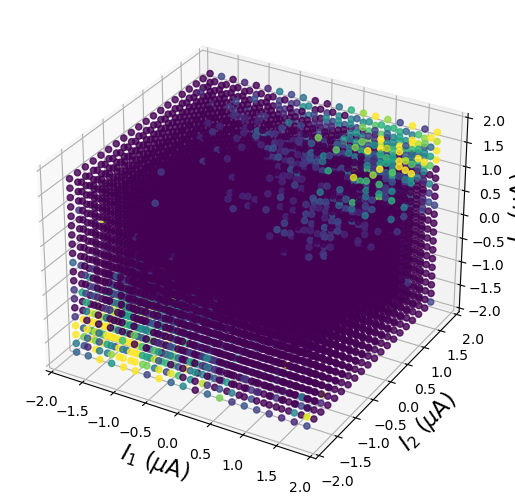

Early stopping triggered at iteration 73


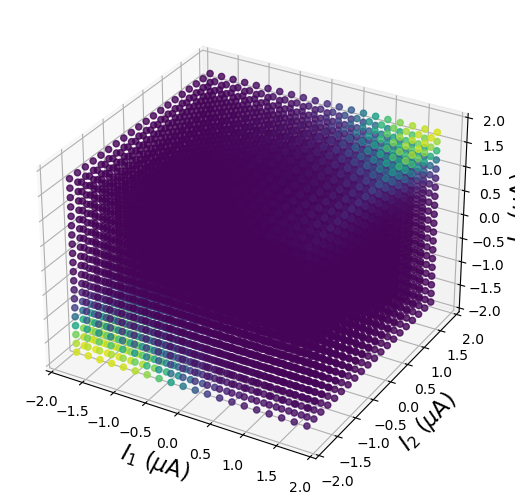

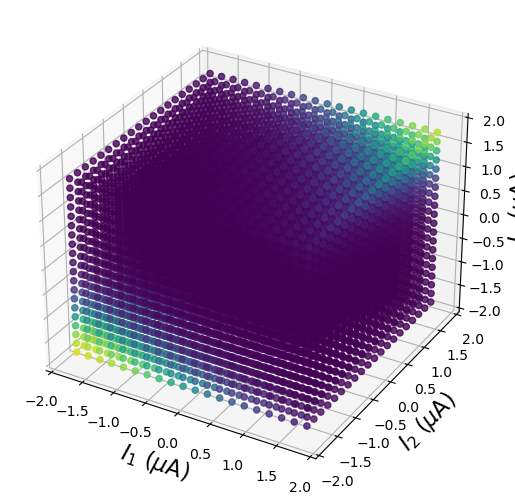

Processing 2020-10-18-5 data006 kilosort_data002/data002
Pattern 500, cell 220
OFF parasol


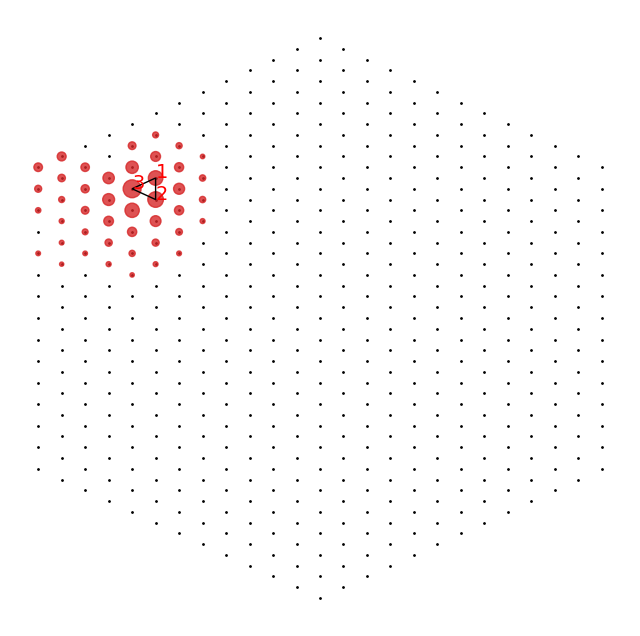

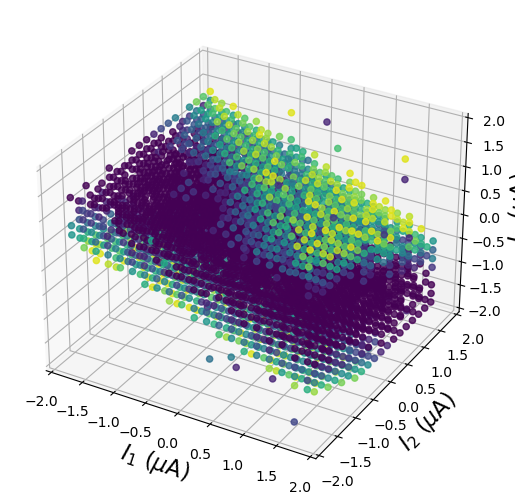

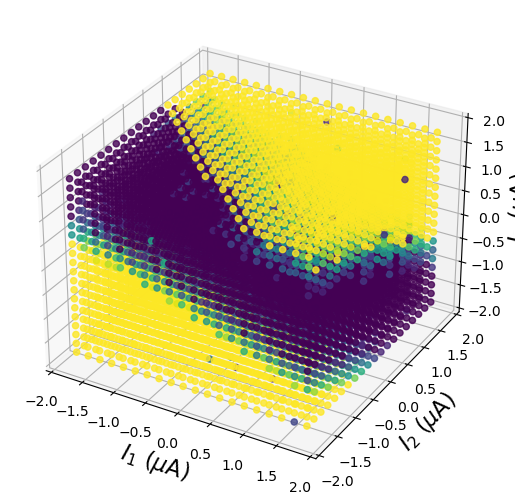

Early stopping triggered at iteration 51


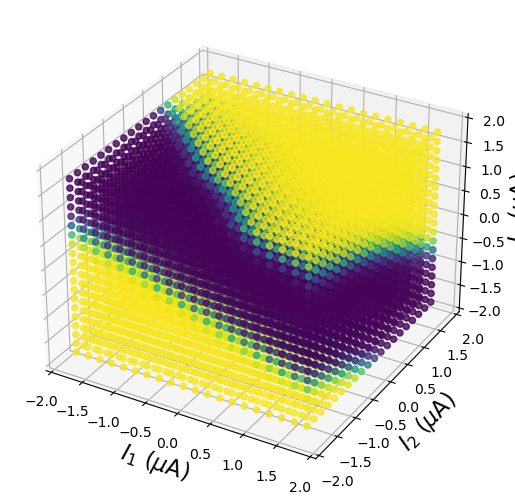

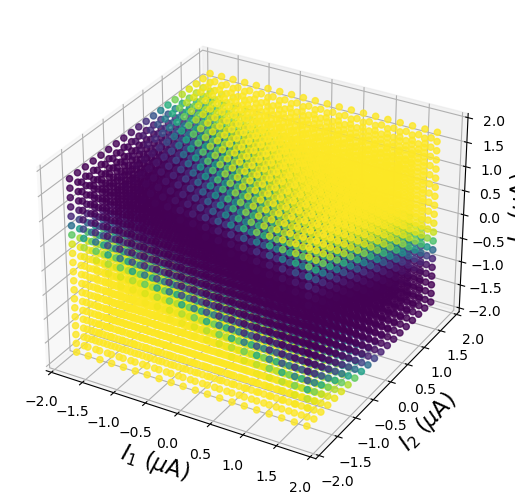

Pattern 103, cell 16
OFF parasol


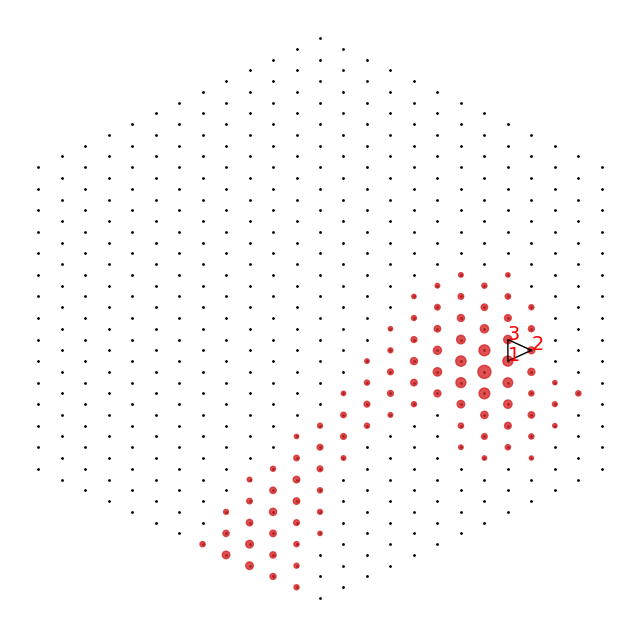

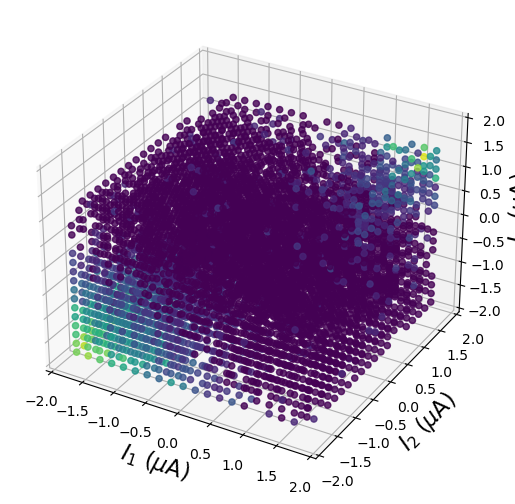

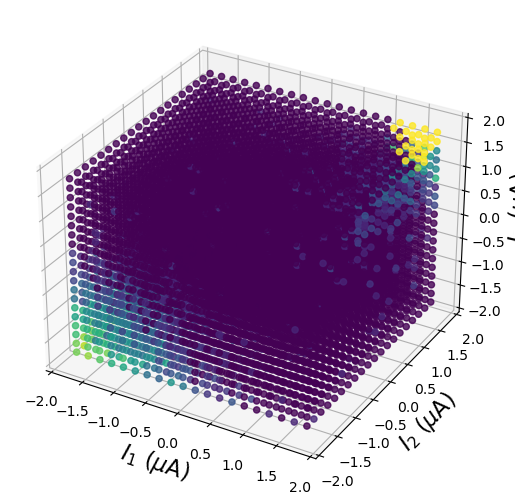

Early stopping triggered at iteration 50


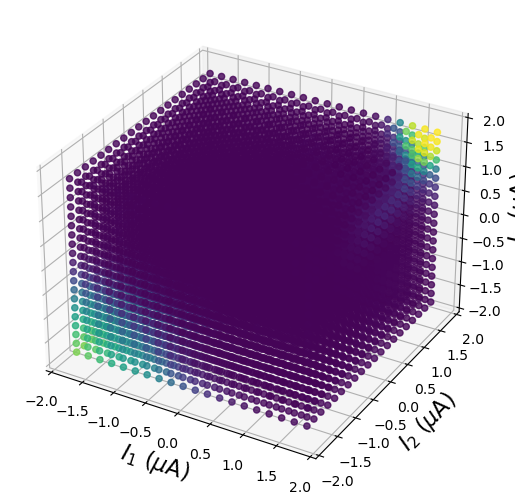

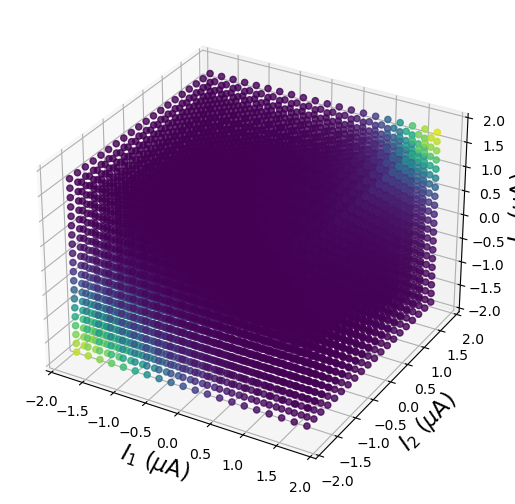

Pattern 500, cell 212
ON Parasol


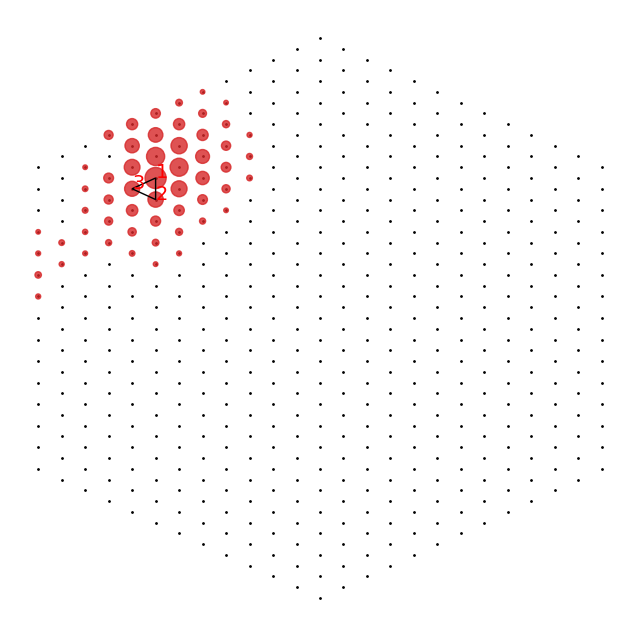

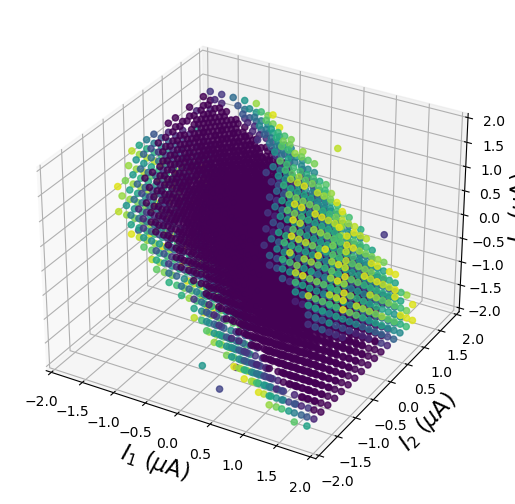

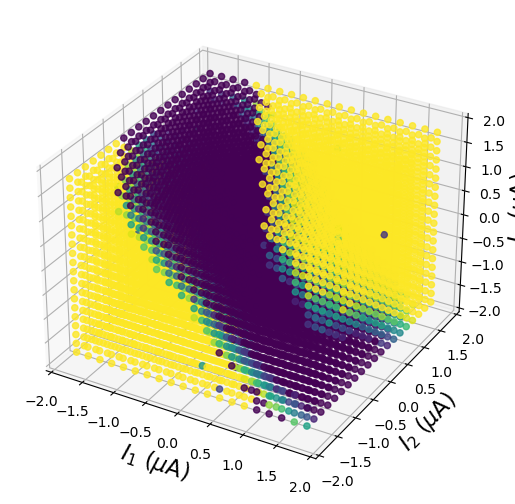

Early stopping triggered at iteration 105


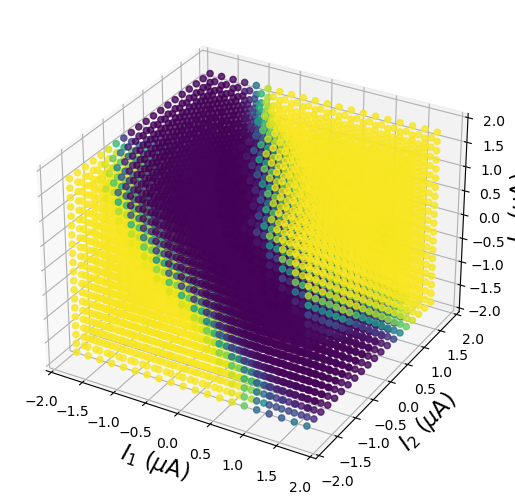

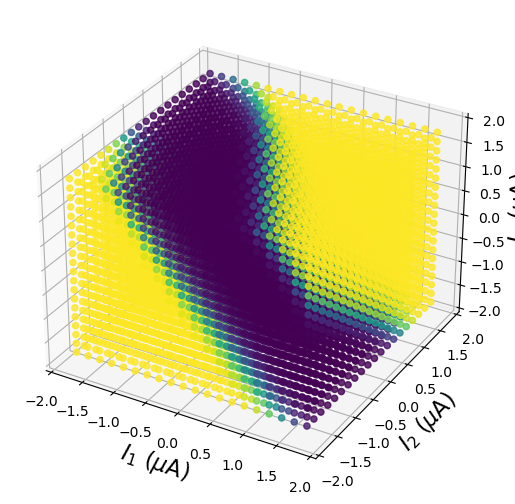

Pattern 500, cell 197
ON Parasol


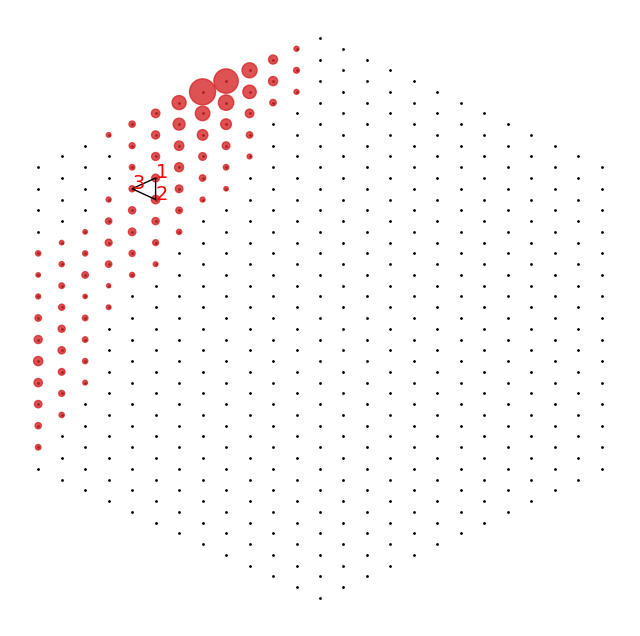

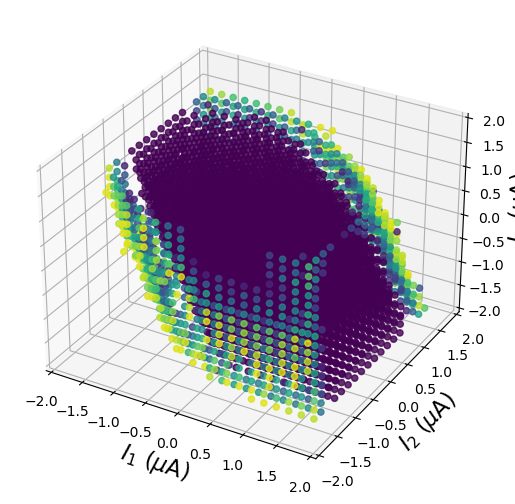

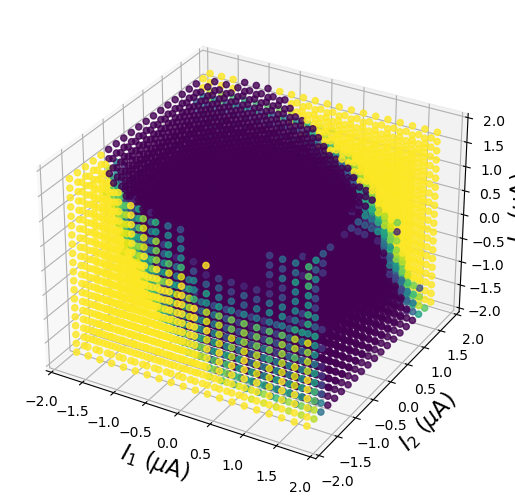

Early stopping triggered at iteration 114


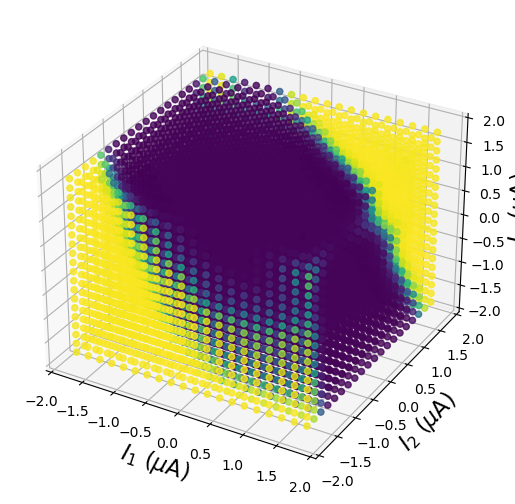

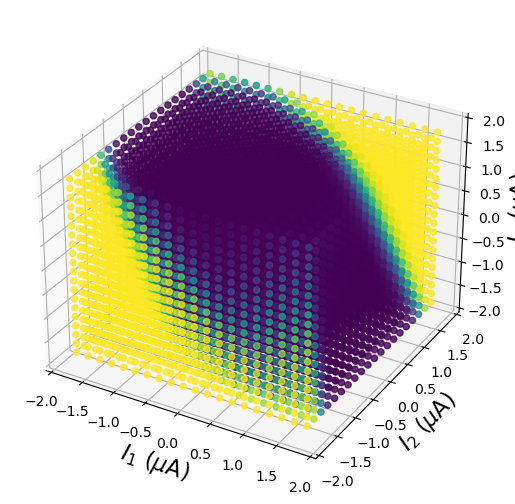

Pattern 500, cell 224
SBCs


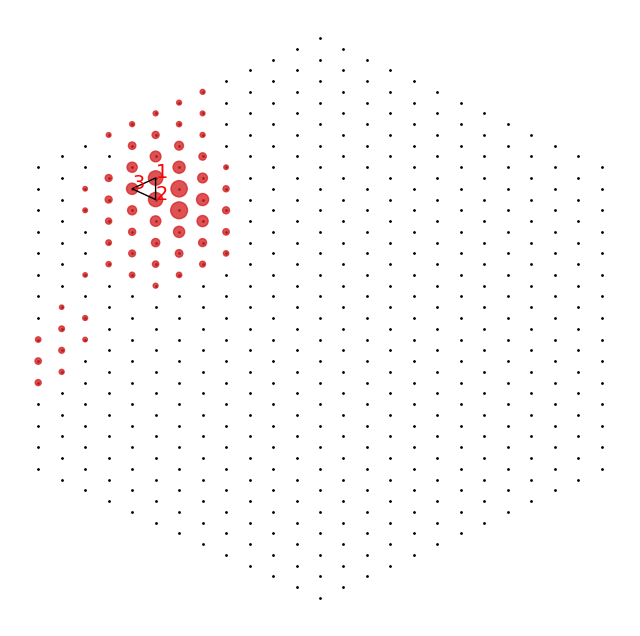

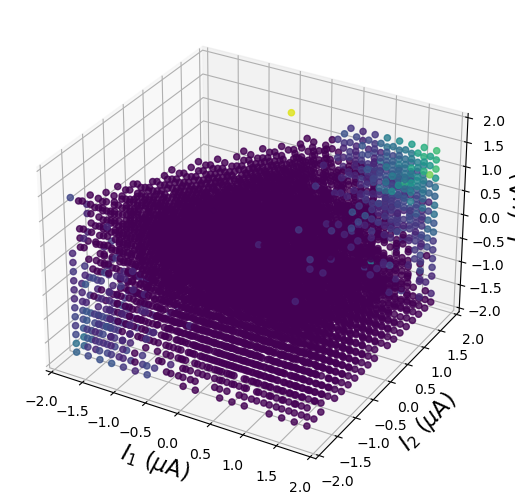

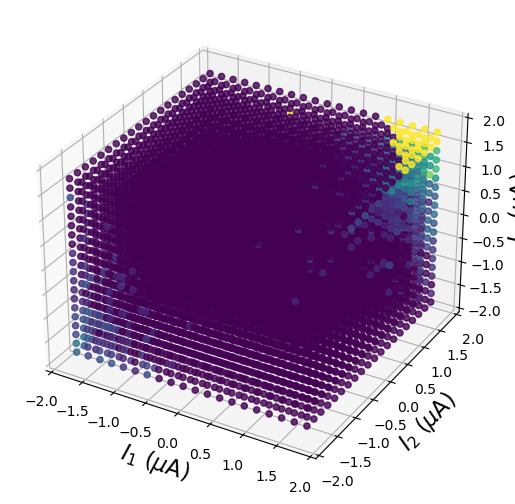

Early stopping triggered at iteration 137


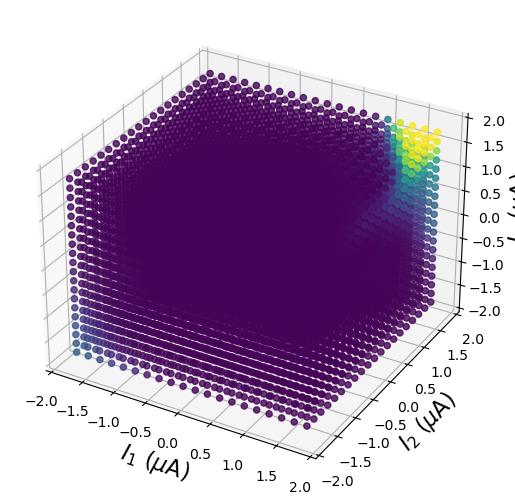

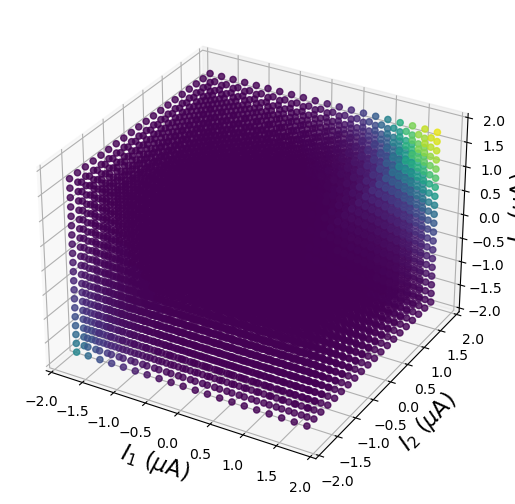

Pattern 103, cell 31
ON Parasol


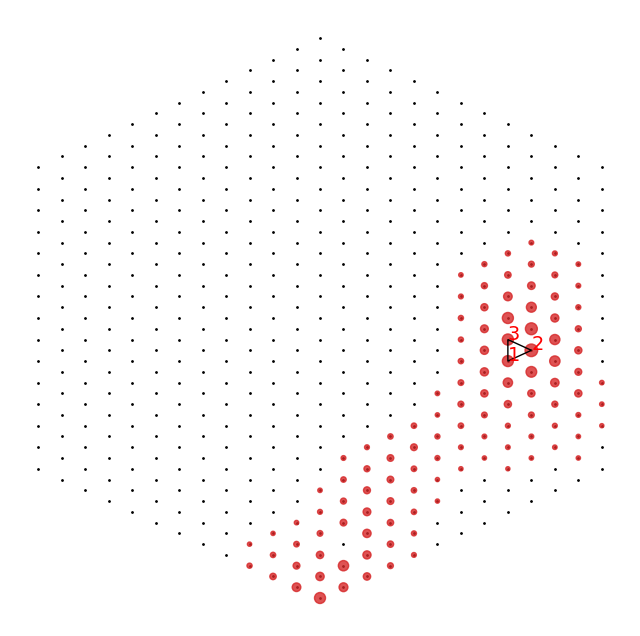

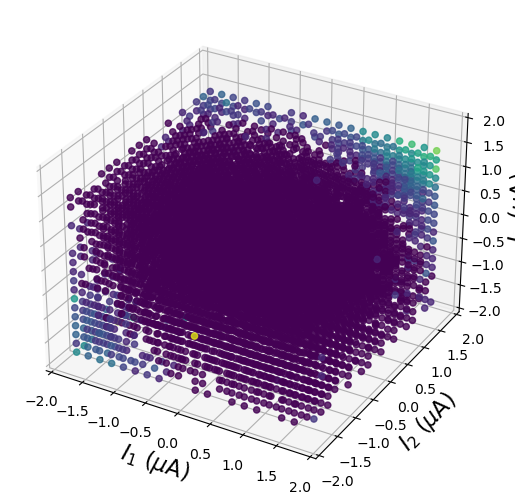

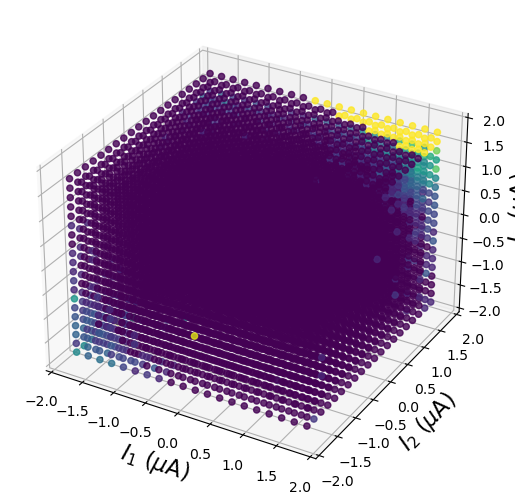

Early stopping triggered at iteration 146


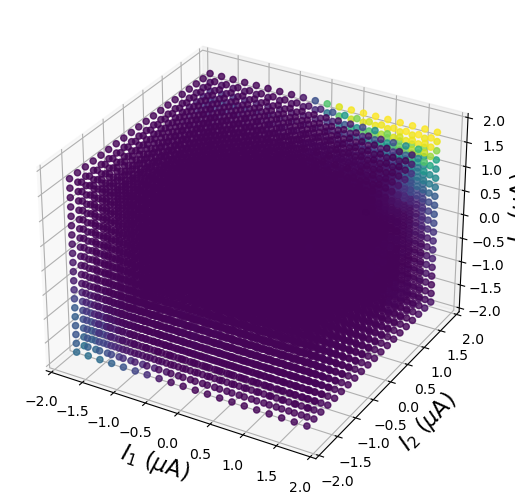

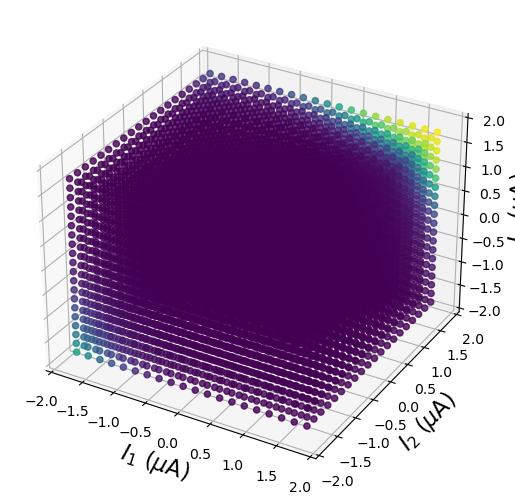

Processing 2021-02-13-6 data003 kilosort_data001/data001
Pattern 28, cell 1
OFF parasol


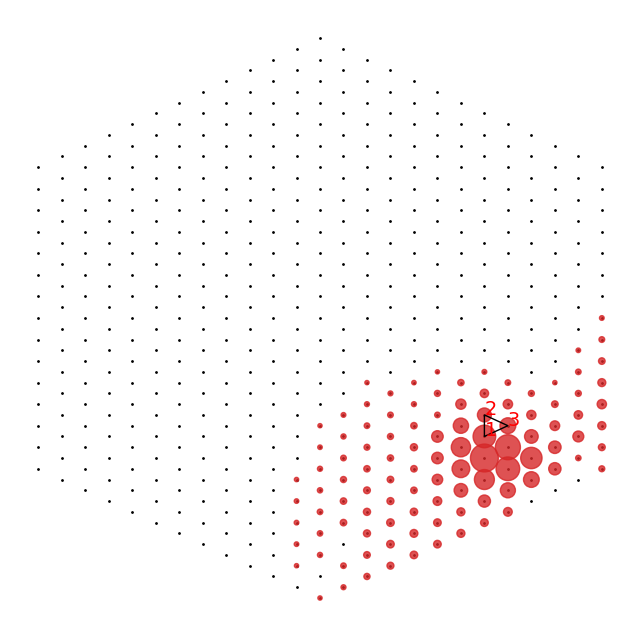

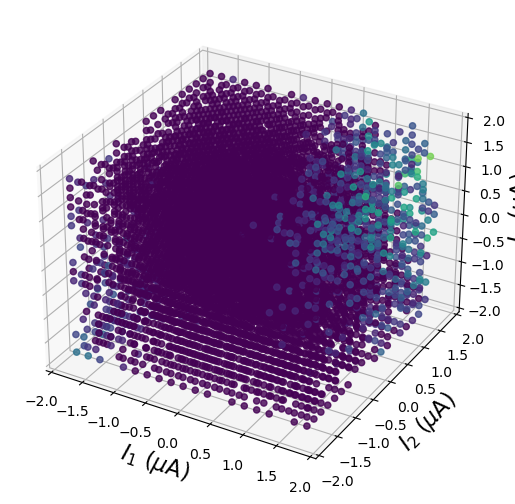

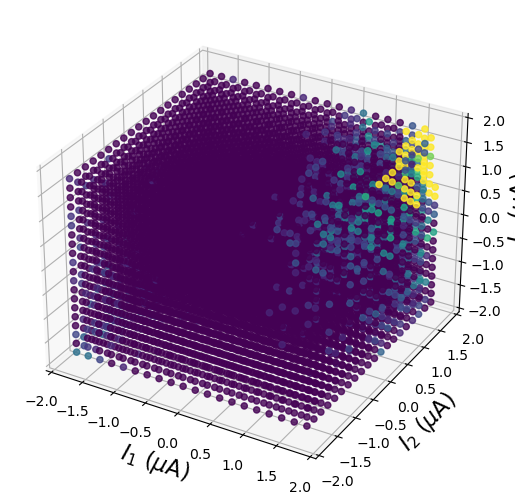

Early stopping triggered at iteration 46


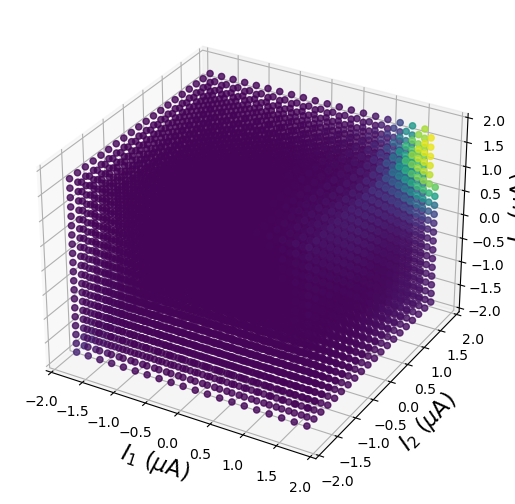

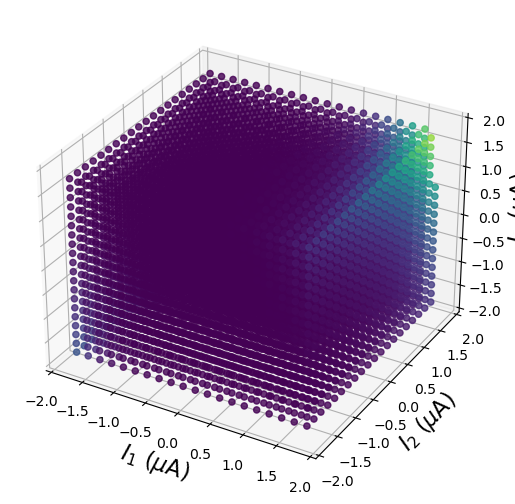

Pattern 186, cell 65
OFF midget


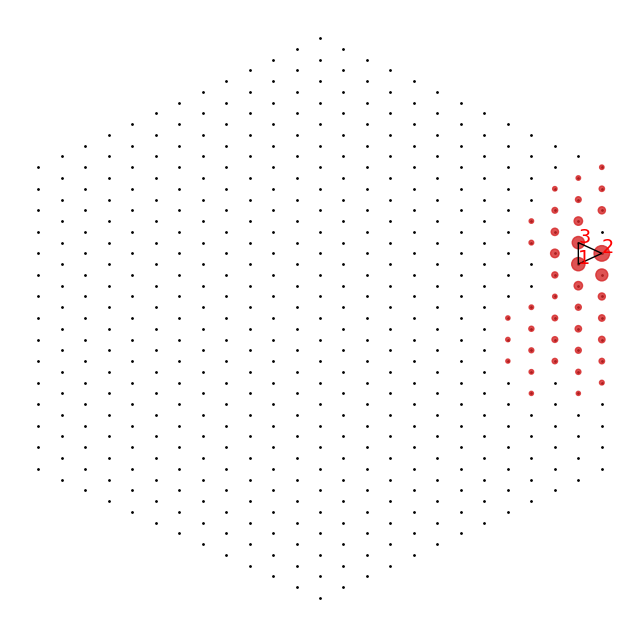

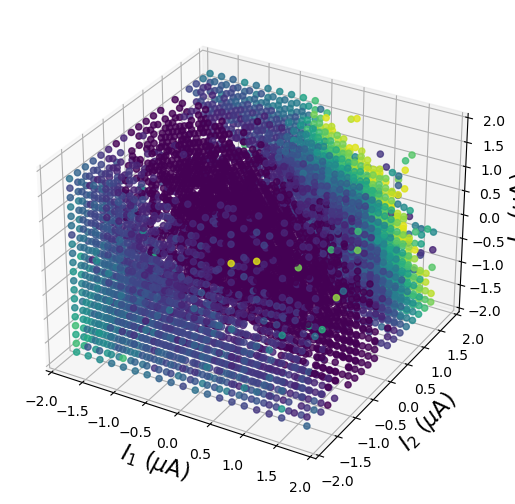

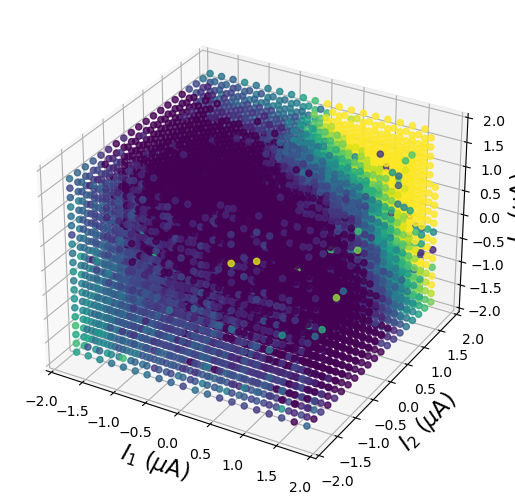

Early stopping triggered at iteration 17


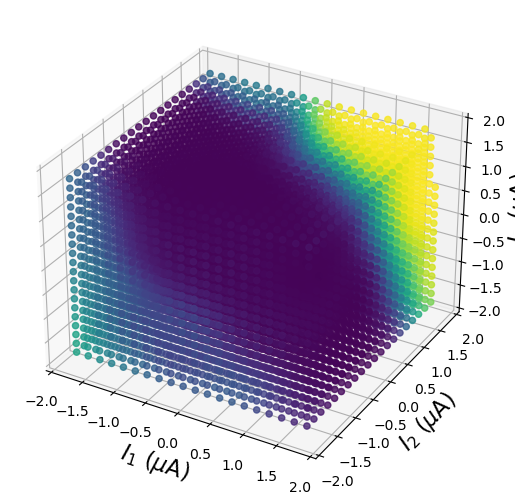

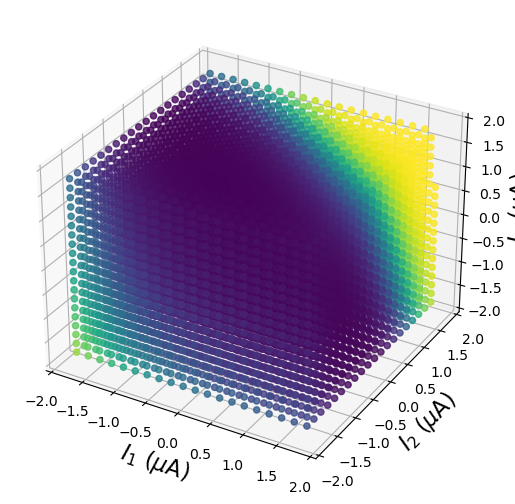

Pattern 28, cell 7
OFF midget


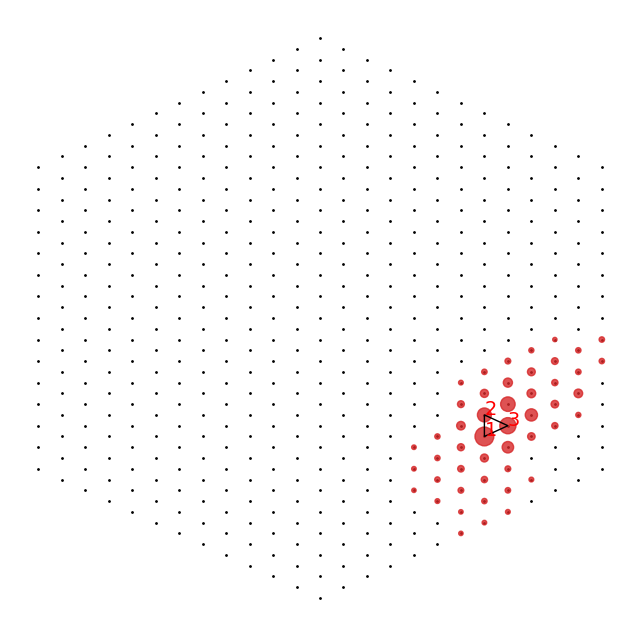

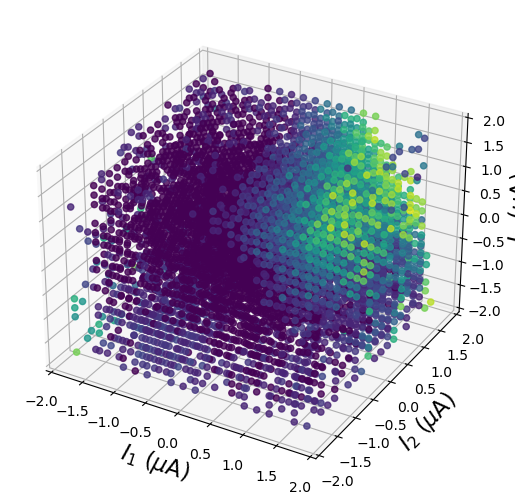

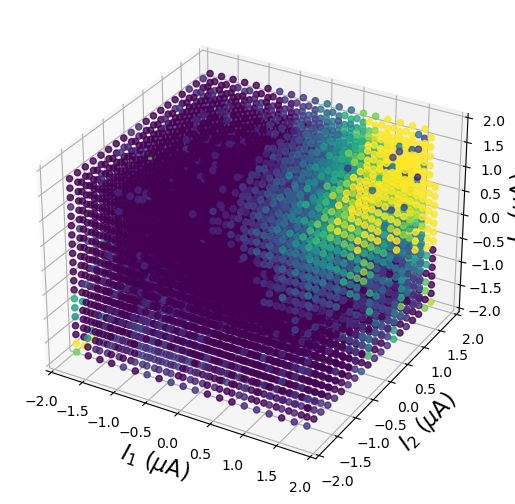

Early stopping triggered at iteration 58


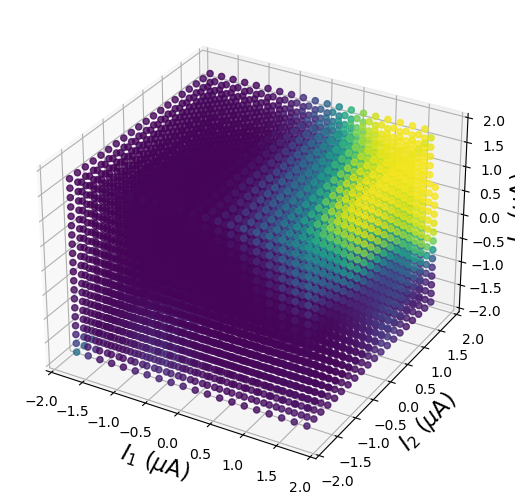

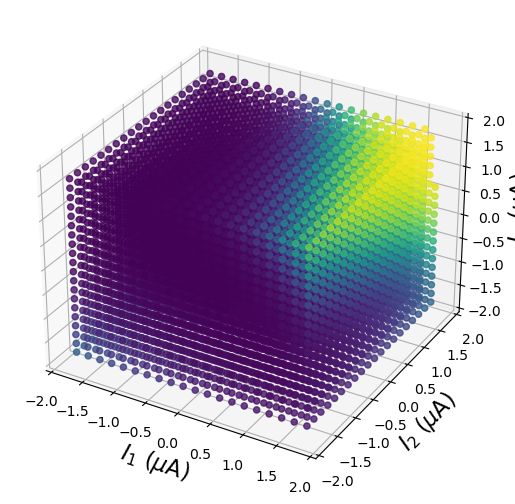

Processing 2021-03-12-0 data002 kilosort_data000/data000
Pattern 290, cell 64
ON parasol


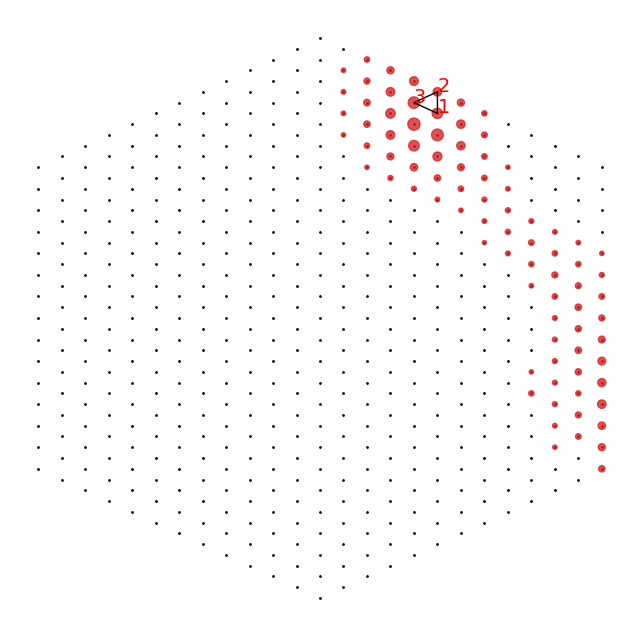

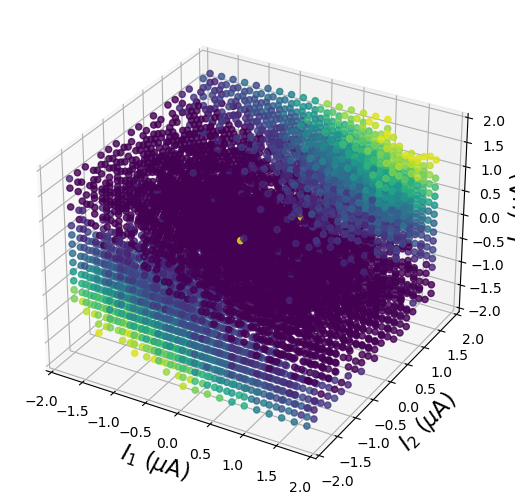

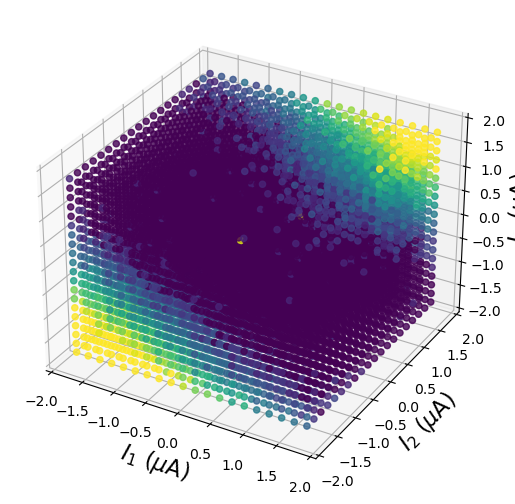

Early stopping triggered at iteration 66


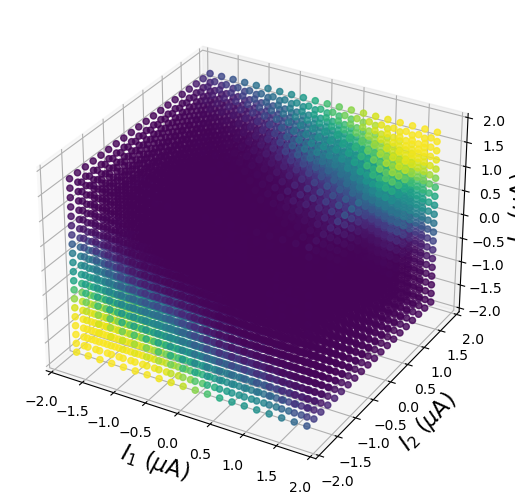

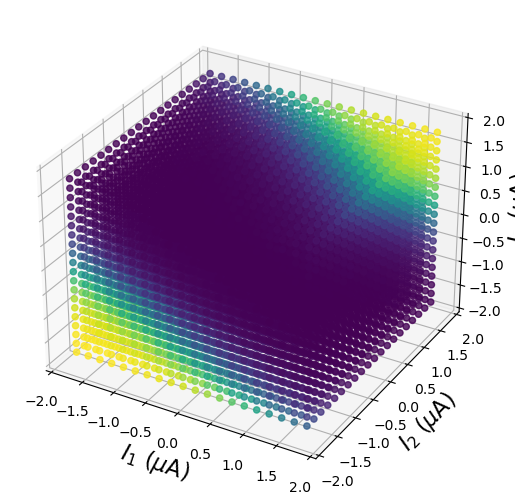

Processing 2021-03-12-3 data003 kilosort_data000/data000
Pattern 448, cell 79
ON midget


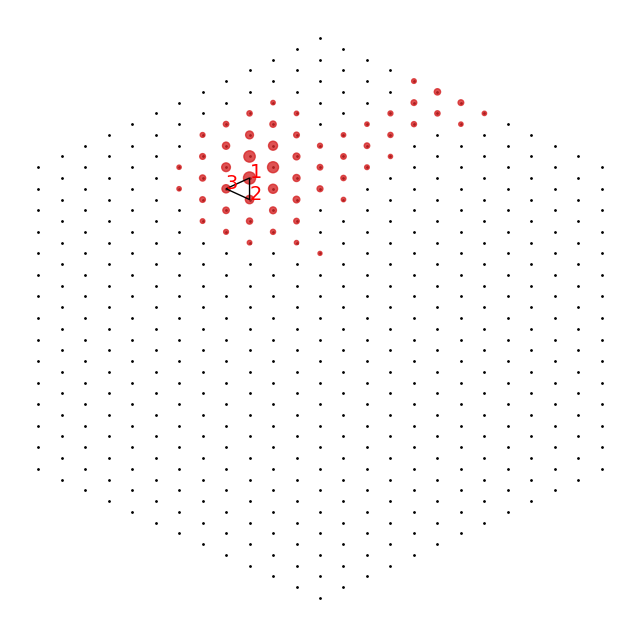

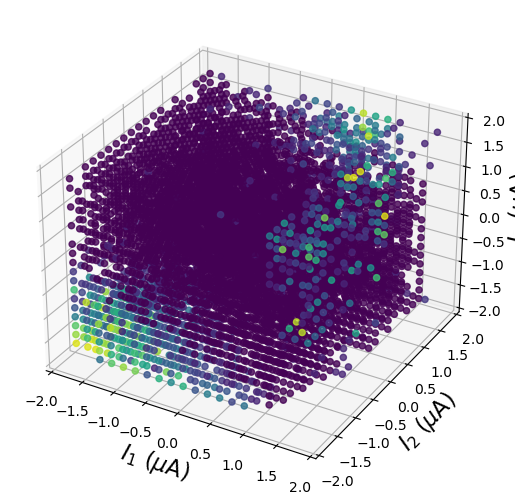

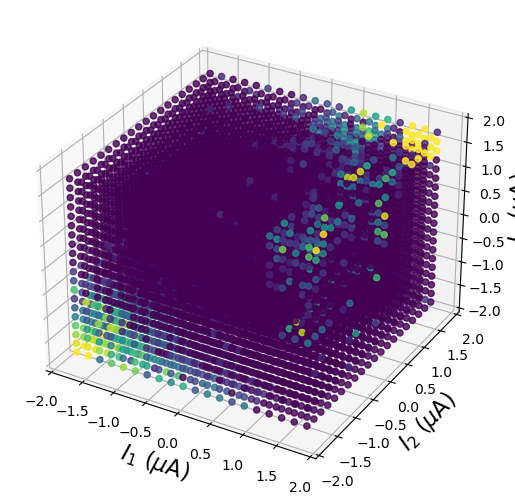

Early stopping triggered at iteration 34


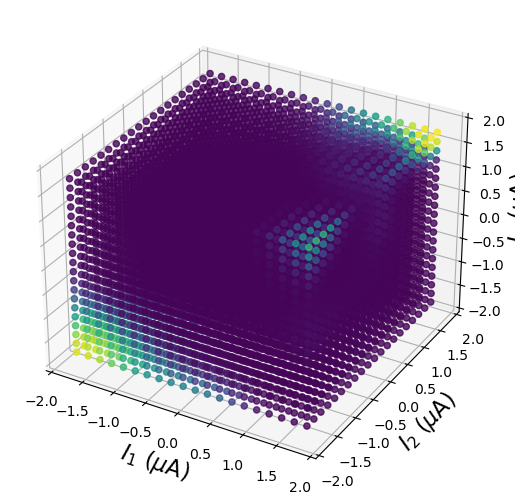

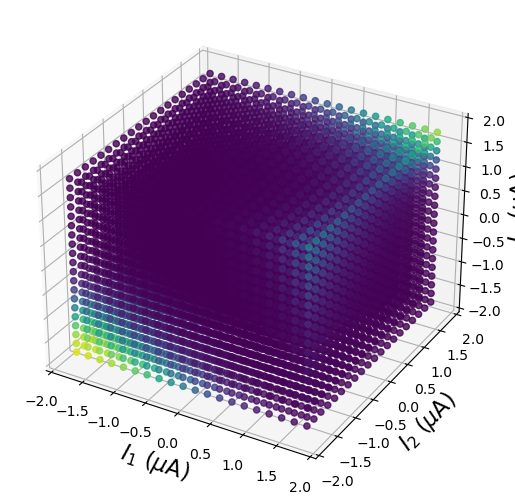

In [3]:
ESTIM_ANALYSIS_BASE = '/Volumes/Lab/Users/praful/outputs/pp_out'
WNOISE_ANALYSIS_BASE = '/Volumes/Analysis'
datasets = ['2020-09-29-2', '2020-09-29-2', '2020-09-29-2', '2020-10-06-7', '2020-10-18-0', '2020-10-18-5', '2021-02-13-6', '2021-03-12-0', '2021-03-12-3']
dataruns = ['data007', 'data008', 'data009', 'data003', 'data003', 'data006', 'data003', 'data002', 'data003']
wnoises = ['kilosort_data006/data006', 'kilosort_data006/data006', 'kilosort_data006/data006', 'kilosort_data000/data000', 
           'kilosort_data000/data000', 'kilosort_data002/data002', 'kilosort_data001/data001', 'kilosort_data000/data000',
           'kilosort_data000/data000']

selectivities = []
ms = [8]
zero_prob = 0.01
slope_bound = 100
R2_thresh = 0.025
reg_param = 0.5
method = 'L-BFGS-B'
reg_method = 'l2'

thr_factor = 1

savepath_base = '/Volumes/Lab/Users/seijiy/outputs'

for dataset, datarun, wnoise in zip(datasets, dataruns, wnoises):
    print(f'Processing {dataset} {datarun} {wnoise}')
    basename = f'/Volumes/Analysis/{dataset}/gsort'

    # Load electrical data and g-sort data
    outpath = os.path.join(basename, datarun, wnoise)
    parameters = loadmat(os.path.join(outpath, 'parameters.mat'))

    cells = parameters['cells'].flatten()
    patterns = parameters['patterns'].flatten()
    num_cells = len(cells)
    num_patterns = max(patterns)
    num_movies = parameters['movies'].flatten()[0]

    all_trials = np.array(np.memmap(os.path.join(outpath, 'trial.dat'),mode='r',shape=(num_patterns, num_movies), dtype='int16'), dtype=int)
    if dataset != '2020-10-06-7':
        amps_gsort = mutils.get_stim_amps_newlv(os.path.join(ESTIM_ANALYSIS_BASE, dataset, datarun), 
                                                len(all_trials))
    else:
        amps_gsort = mutils.get_stim_amps_newlv(os.path.join(ESTIM_ANALYSIS_BASE, dataset, 'data005'), 
                                                len(all_trials))

    path = os.path.join(basename, datarun, wnoise)
    file_list = os.listdir(path)

    vstim_datapath = os.path.join(WNOISE_ANALYSIS_BASE, dataset, wnoise)
    vstim_datarun = os.path.basename(os.path.normpath(vstim_datapath))
    vcd = vl.load_vision_data(vstim_datapath, vstim_datarun,
                            include_neurons=True,
                            include_ei=True,
                            include_params=True,
                            include_noise=True)
    coords = vcd.electrode_map

    patterns = {}
    for file in file_list:
        if file.endswith('.mat') and file.startswith('fit'):
            pattern_cell = file.split('.mat')[0].split('_')[-1]
            p, c = pattern_cell.replace('p', '').split('c')
            p = int(p)
            c = int(c)

            if dataset != '2020-10-06-7':
                stim_elecs = mutils.get_stim_elecs_newlv(os.path.join(ESTIM_ANALYSIS_BASE, dataset, datarun), 
                                                        p)
            else:
                stim_elecs = mutils.get_stim_elecs_newlv(os.path.join(ESTIM_ANALYSIS_BASE, dataset, 'data005'), 
                                                        p)
            if not is_valid_set(stim_elecs):
                continue

            print(f'Pattern {p}, cell {c}')

            fig, ax = plt.subplots(figsize=(8, 8))
            ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")
            plt.axis('off')

            print(vcd.get_cell_type_for_cell(c))
            good_inds, EI = mutils.get_collapsed_ei_thr(vcd, c, thr_factor)
            scat = ax.scatter(coords[good_inds, 0], coords[good_inds, 1], s=np.abs(EI[good_inds]) * 3, alpha=0.8,#)
                            c='tab:red')

            # Get the coordinates of the stimulation electrodes
            stim_coords = coords[stim_elecs - 1, :]

            for l, txt in enumerate(stim_elecs):
                ax.annotate(l+1, (coords[stim_elecs[l]-1, 0], coords[stim_elecs[l]-1, 1]), color='r', fontsize=14)

            # Draw a triangle connecting the stimulation electrodes
            if stim_coords.shape[0] == 3:  # Ensure we have exactly 3 electrodes
                triangle = plt.Polygon(stim_coords, edgecolor='k', fill=False, linewidth=1)
                ax.add_patch(triangle)
            else:
                print(f"Expected 3 stimulation electrodes, but got {stim_coords.shape[0]}.")

            plt.show()
            
            savepath = os.path.join(savepath_base, f'triplet_{dataset}_p{p}_c{c}.mat')
            savedict = {}
            savedict['cell'] = c
            savedict['ei'] = vcd.get_ei_for_cell(c).ei
            savedict['stim_elecs'] = stim_elecs
            savedict['piece'] = dataset
            savedict['wnoise'] = wnoise
            savedict['estim_datarun'] = datarun
            savedict['amps_all'] = deepcopy(amps_gsort)

            params = loadmat(os.path.join(path, file))['params_true']
            X = loadmat(os.path.join(path, file))['amps_fit']
            probs_fit = loadmat(os.path.join(path, file))['probs_fit'].flatten()

            fig = plt.figure(1)
            fig.clear()
            ax = Axes3D(fig, auto_add_to_figure=False)
            fig.add_axes(ax)
            plt.xlabel(r'$I_1$ ($\mu$A)', fontsize=16)
            plt.ylabel(r'$I_2$ ($\mu$A)', fontsize=16)
            plt.xlim(-2, 2)
            plt.ylim(-2, 2)
            ax.set_zlim(-2, 2)
            ax.set_zlabel(r'$I_3$ ($\mu$A)', fontsize=16)

            scat = ax.scatter(X[:, 0], 
                                X[:, 1],
                                X[:, 2], marker='o', 
                                c=probs_fit, s=20, alpha=0.8, vmin=0, vmax=1)
            plt.show()

            savedict['amps_raw'] = deepcopy(X)
            savedict['probs_raw'] = deepcopy(probs_fit)
            
            # Find indices of rows in A corresponding to rows in B, preserving order
            indices = [np.where(np.all(amps_gsort == row, axis=1))[0][0] for row in X]
            remaining_inds = np.setdiff1d(np.arange(len(amps_gsort)), indices)
            amps_remaining = deepcopy(amps_gsort[remaining_inds])

            probs_flipped = np.zeros(len(amps_gsort))
            probs_flipped[indices] = probs_fit

            probs_remaining = fitting.sigmoidND_nonlinear(sm.add_constant(amps_remaining, has_constant='add'),
                                                        params)
            probs_flipped[remaining_inds] = np.where(probs_remaining > 0.5, 1, 0)
            
            num_trials = all_trials[p-1]
            savedict['trials_all'] = deepcopy(num_trials)
            savedict['trials_raw'] = deepcopy(num_trials[indices])

            fig = plt.figure(2)
            fig.clear()
            ax = Axes3D(fig, auto_add_to_figure=False)
            fig.add_axes(ax)
            plt.xlabel(r'$I_1$ ($\mu$A)', fontsize=16)
            plt.ylabel(r'$I_2$ ($\mu$A)', fontsize=16)
            plt.xlim(-2, 2)
            plt.ylim(-2, 2)
            ax.set_zlim(-2, 2)
            ax.set_zlabel(r'$I_3$ ($\mu$A)', fontsize=16)

            scat = ax.scatter(amps_gsort[:, 0], 
                                amps_gsort[:, 1],
                                amps_gsort[:, 2], marker='o', 
                                c=probs_flipped, s=20, alpha=0.8, vmin=0, vmax=1)
            plt.show()

            savedict['probs_flipped'] = deepcopy(probs_flipped)

            Xdata_full = deepcopy(amps_gsort)
            selec_probs_full = np.clip(probs_flipped, 1e-2, 1-1e-2)
            y_full = np.log(selec_probs_full/(1-selec_probs_full))

            # Assuming Xdata and y are in numpy format, convert them to torch tensors
            amps_plot_torch = torch.tensor(amps_gsort, dtype=torch.float32)
            X_train_full = torch.tensor(Xdata_full, dtype=torch.float32)
            y_train_full = torch.tensor(y_full.reshape(-1), dtype=torch.float32)

            device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
            amps_plot_torch = amps_plot_torch.to(device)
            X_train_full = X_train_full.to(device)
            y_train_full = y_train_full.to(device)

            # Define the GP Model
            class GPRegressionModel(gpytorch.models.ExactGP):
                def __init__(self, train_x, train_y, likelihood):
                    super(GPRegressionModel, self).__init__(train_x, train_y, likelihood)
                    self.mean_constant = ConstantMean()
                    # self.mean_linear = LinearMean(input_size=train_x.size(1))
                    self.covar_module = RBFKernel()

                def forward(self, x):
                    # Add the constant and linear mean components manually
                    mean_x = self.mean_constant(x)# + self.mean_linear(x)
                    covar_x = self.covar_module(x)
                    return gpytorch.distributions.MultivariateNormal(mean_x, covar_x)

            # Early stopping class
            class EarlyStopping:
                def __init__(self, patience=10, min_delta=0.0):
                    """
                    :param patience: How many epochs to wait before stopping when loss isn't decreasing.
                    :param min_delta: Minimum change in monitored loss to qualify as an improvement.
                    """
                    self.patience = patience
                    self.min_delta = min_delta
                    self.counter = 0
                    self.best_loss = None
                    self.stop = False

                def step(self, val_loss):
                    if self.best_loss is None:
                        self.best_loss = val_loss
                    elif val_loss > self.best_loss - self.min_delta:
                        self.counter += 1
                        if self.counter >= self.patience:
                            self.stop = True
                    else:
                        self.best_loss = val_loss
                        self.counter = 0

            # Initialize the likelihood and model
            likelihood_full = GaussianLikelihood()
            model_full = GPRegressionModel(X_train_full, y_train_full, likelihood_full)

            model_full = model_full.to(device)
            likelihood_full = likelihood_full.to(device)

            # Set model and likelihood in training mode
            model_full.train()
            likelihood_full.train()

            # Use an optimizer
            optimizer_full = torch.optim.AdamW([{'params': model_full.parameters()}], lr=1e-2)

            # Set up marginal log likelihood for GPyTorch
            mll_full = gpytorch.mlls.ExactMarginalLogLikelihood(likelihood_full, model_full)

            # Early stopping setup
            early_stopping_full = EarlyStopping(patience=10, min_delta=1e-3)

            # Training loop with early stopping
            training_iter = 10000
            losses_train_full = []
            for j in range(training_iter):
                model_full.train()
                likelihood_full.train()
                optimizer_full.zero_grad()
                output_train_full = model_full(X_train_full)

                loss_train_full = -mll_full(output_train_full, y_train_full)

                losses_train_full.append(loss_train_full.item())
                loss_train_full.backward()
                optimizer_full.step()
                early_stopping_full.step(loss_train_full.item())

                if early_stopping_full.stop:
                    print(f"Early stopping triggered at iteration {j + 1}")
                    break

                # if j % 10 == 0:
                #     print(f"Iteration {j + 1}/{training_iter} - Training Loss: {loss_train_full.item()}")
                #     print(f"  Lengthscale: {model_full.covar_module.lengthscale}")
                #     print(f"  Noise: {model_full.likelihood.noise_covar.noise}")

            # Model evaluation
            model_full.eval()
            likelihood_full.eval()
            with torch.no_grad():
                # Get model predictions
                predictions_full = likelihood_full(model_full(amps_plot_torch))
                mean_full = predictions_full.mean
                var_full = predictions_full.variance
                lower_full, upper_full = predictions_full.confidence_region()

            probs_smooth = 1/(1 + np.exp(-mean_full.cpu().numpy().flatten()))
        
            fig = plt.figure(3)
            fig.clear()
            ax = Axes3D(fig, auto_add_to_figure=False)
            fig.add_axes(ax)
            plt.xlabel(r'$I_1$ ($\mu$A)', fontsize=16)
            plt.ylabel(r'$I_2$ ($\mu$A)', fontsize=16)
            plt.xlim(-2, 2)
            plt.ylim(-2, 2)
            ax.set_zlim(-2, 2)
            ax.set_zlabel(r'$I_3$ ($\mu$A)', fontsize=16)

            scat = ax.scatter(amps_gsort[:, 0], 
                                amps_gsort[:, 1],
                                amps_gsort[:, 2], marker='o', 
                                c=probs_smooth, s=20, alpha=0.8, vmin=0, vmax=1)
            plt.show()

            savedict['probs_gp'] = deepcopy(probs_smooth)
        
            X = deepcopy(amps_gsort)
            probs_fit = deepcopy(probs_flipped)
            T = deepcopy(num_trials)

            w_inits = []
            for m in ms:
                w_init = np.array(np.random.normal(size=(m, amps_gsort.shape[1]+1)))
                z = 1 - (1 - zero_prob)**(1/len(w_init))
                w_init[:, 0] = np.clip(w_init[:, 0], None, np.log(z/(1-z)))
                w_init[:, 1:] = np.clip(w_init[:, 1:], -slope_bound, slope_bound)
                w_inits.append(w_init)

            opt, _ = fitting.fit_surface_earlystop(X, probs_fit, T, w_inits,
                                        reg_method=reg_method, reg=[reg_param], slope_bound=slope_bound,
                                        zero_prob=zero_prob, method=method,
                                        R2_thresh=R2_thresh                           
            )
            params_multisite, _, _ = opt
            probs_pred_multisite = fitting.sigmoidND_nonlinear(sm.add_constant(amps_gsort, has_constant='add'), 
                                                                    params_multisite)
            
            fig = plt.figure(3)
            fig.clear()
            ax = Axes3D(fig, auto_add_to_figure=False)
            fig.add_axes(ax)
            plt.xlabel(r'$I_1$ ($\mu$A)', fontsize=16)
            plt.ylabel(r'$I_2$ ($\mu$A)', fontsize=16)
            plt.xlim(-2, 2)
            plt.ylim(-2, 2)
            ax.set_zlim(-2, 2)
            ax.set_zlabel(r'$I_3$ ($\mu$A)', fontsize=16)

            scat = ax.scatter(amps_gsort[:, 0], 
                                amps_gsort[:, 1],
                                amps_gsort[:, 2], marker='o', 
                                c=probs_pred_multisite, s=20, alpha=0.8, vmin=0, vmax=1)
            plt.show()

            savedict['probs_multisite'] = deepcopy(probs_pred_multisite)
            savedict['params_multisite'] = deepcopy(params_multisite)

            savemat(savepath, savedict)
            torch.save(model_full.state_dict(), savepath.replace('.mat', '_gp_model.pth'))